Arneodo Alice - 10628811

Beretta Davide - 10656835

Bruno Giovanni Maria - 10593365

Buono Salvatore - 10600540



#SQUAD 2.0 

#Google drive setup and data loading

In [ ]:
import json
import pandas as pd
import numpy as np

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
#Davide
os.chdir('/content/drive/MyDrive/Uni/NLP/Project')
#Giovanni
#os.chdir('/content/drive/MyDrive/NLP/NLP_project')
#Salvatore
#os.chdir('/content/drive/MyDrive/Project')
#Alice
#os.chdir('/content/drive/MyDrive/NLP - Alice/Project')
os.getcwd()

'/content/drive/MyDrive/Uni/NLP/Project'

##Retrieving the dataset

We downloaded the dataset from the official github repository of the challenge: https://rajpurkar.github.io/SQuAD-explorer/

Another way to load the data would have been directly import it through the "datasets" library from huggingface: https://huggingface.co/datasets/squad_v2

The dataset is composed by Wikipedia pages from which some paragraphs have been extracted. For each paragraph there are several questions with the corresponding answer.

The task is to learn to reply to the questions by finding the correct answer in the corresponding paragraph.

In [ ]:
# Opening JSON file
f = open('train_data.json')

# returns JSON object as
# a dictionary
data = json.load(f)
data = data["data"]
data[0]

{'title': 'Beyoncé',
 'paragraphs': [{'qas': [{'question': 'When did Beyonce start becoming popular?',
     'id': '56be85543aeaaa14008c9063',
     'answers': [{'text': 'in the late 1990s', 'answer_start': 269}],
     'is_impossible': False},
    {'question': 'What areas did Beyonce compete in when she was growing up?',
     'id': '56be85543aeaaa14008c9065',
     'answers': [{'text': 'singing and dancing', 'answer_start': 207}],
     'is_impossible': False},
    {'question': "When did Beyonce leave Destiny's Child and become a solo singer?",
     'id': '56be85543aeaaa14008c9066',
     'answers': [{'text': '2003', 'answer_start': 526}],
     'is_impossible': False},
    {'question': 'In what city and state did Beyonce  grow up? ',
     'id': '56bf6b0f3aeaaa14008c9601',
     'answers': [{'text': 'Houston, Texas', 'answer_start': 166}],
     'is_impossible': False},
    {'question': 'In which decade did Beyonce become famous?',
     'id': '56bf6b0f3aeaaa14008c9602',
     'answers': [{'text

In [ ]:
# Opening JSON file
f = open('dev-v2.0.json')

# returns JSON object as
# a dictionary
dev_data = json.load(f)

dev_data = dev_data["data"]

#Dataset Exploration

We kept the train-test split as provided in github repository, so we had 130319 samples of training data and 11873 samples of testing data, that are the ones used to evaluate the models to be put into the leaderboard of the challenge. Moreover, we further split the training set into train and validation sets, keeping 80% of the samples for training and 20% for validation. We used validation set to keep track of the performances of the model during the training, while we kept the test set for evaluating and comparing the models after the training.

##DataFrame setup
At first, the structure of the dataset may result quite complex to understand but after the following preprocessing steps, we summarized it in a pandas dataframe, which is quite simple

In [ ]:
train_set=[]

for elem in data:
  title=elem["title"]
  for paragraph in elem["paragraphs"]:
    context=paragraph["context"]
    for qas in paragraph["qas"]:
      train_dict={}
      train_dict["title"]=title
      train_dict["context"]=context
      train_dict["question"]=qas["question"]
      train_dict["id_question"]=qas["id"]
      for answer in qas["answers"]:
        train_dict["answer_text"]=answer["text"]
        train_dict["answer_start"]=answer["answer_start"]
      train_set.append(train_dict)
train_set

[{'title': 'Beyoncé',
  'context': 'Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress. Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny\'s Child. Managed by her father, Mathew Knowles, the group became one of the world\'s best-selling girl groups of all time. Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".',
  'question': 'When did Beyonce start becoming popular?',
  'id_question': '56be85543aeaaa14008c9063',
  'answer_text': 'in the late 1990s',
  'answer_start': 269},
 {'title': 'Beyoncé',
  'context': 'Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born

In [ ]:
#dataset print
df = pd.DataFrame(train_set)
df

,title,context,question,id_question,answer_text,answer_start
0,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce start becoming popular?,56be85543aeaaa14008c9063,in the late 1990s,269.0
1,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,What areas did Beyonce compete in when she was...,56be85543aeaaa14008c9065,singing and dancing,207.0
2,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce leave Destiny's Child and bec...,56be85543aeaaa14008c9066,2003,526.0
3,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In what city and state did Beyonce grow up?,56bf6b0f3aeaaa14008c9601,"Houston, Texas",166.0
4,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In which decade did Beyonce become famous?,56bf6b0f3aeaaa14008c9602,late 1990s,276.0
...,...,...,...,...,...,...
130314,Matter,"The term ""matter"" is used throughout physics i...",Physics has broadly agreed on the definition o...,5a7e070b70df9f001a875439,NaN,NaN
130315,Matter,"The term ""matter"" is used throughout physics i...",Who coined the term partonic matter?,5a7e070b70df9f001a87543a,NaN,NaN
130316,Matter,"The term ""matter"" is used throughout physics i...",What is another name for anti-matter?,5a7e070b70df9f001a87543b,NaN,NaN
130317,Matter,"The term ""matter"" is used throughout physics i...",Matter usually does not need to be used in con...,5a7e070b70df9f001a87543c,NaN,NaN


Each *sample* corresponds to an aswered question and it is identified by a code called **'id_question'**.

The other fields composing these samples are:



*   **title** - it is the name of the Wikipedia page from which the paragraph has been extracted
*   **context** - it is the content of the paragraph, containing some information about the subject expressed in the title
*   **question** - it contains the actual text of the question, that may refer to the associated context
*   **answer_text** - it contains the actual text of the answer, if it is contained in the context
*   **answer_start** - it contains the position in which the answer starts in the context

If we want to make a comparison between this dataset and the one of the first version of the challenge, our version contains several unanswerable questions, that do not have an answer retrievable from the associated context.

##Analysis



### Context analysis
As first analysis, we extract the texts of all the contexts, assuming that the questions do not contain much different words from the contexts they refer to. Then we compute the length of the overall vocabulary after deleting punctuation, stopwords and making each character lower case.

####Contexts extraction

In [ ]:
df_context=df[['title', 'context']]
df_context.drop_duplicates(['context'],keep='first',inplace=True)
df_context

<ipython-input-11-2d9bf34590aa>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_context.drop_duplicates(['context'],keep='first',inplace=True)


,title,context
0,Beyoncé,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...
15,Beyoncé,Following the disbandment of Destiny's Child i...
27,Beyoncé,"A self-described ""modern-day feminist"", Beyonc..."
39,Beyoncé,"Beyoncé Giselle Knowles was born in Houston, T..."
52,Beyoncé,Beyoncé attended St. Mary's Elementary School ...
...,...,...
130294,Matter,Isaac Newton (1643–1727) inherited Descartes' ...
130299,Matter,"There is an entire literature concerning the ""..."
130304,Matter,In the late 19th century with the discovery of...
130309,Matter,These quarks and leptons interact through four...


In [ ]:
#contexts join into an array

import numpy as np
context_array=np.array(df_context['context'].values).flatten()
context_array

array(['Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress. Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny\'s Child. Managed by her father, Mathew Knowles, the group became one of the world\'s best-selling girl groups of all time. Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".',
       'Following the disbandment of Destiny\'s Child in June 2005, she released her second solo album, B\'Day (2006), which contained hits "Déjà Vu", "Irreplaceable", and "Beautiful Liar". Beyoncé also ventured into acting, with a Golden Globe-nominated performance in Dreamgirls (2006), and

In [ ]:
#flatten all contexts in a single variable

flatten_context = '.'.join(map(str, context_array))
flatten_context

'Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress. Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny\'s Child. Managed by her father, Mathew Knowles, the group became one of the world\'s best-selling girl groups of all time. Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy"..Following the disbandment of Destiny\'s Child in June 2005, she released her second solo album, B\'Day (2006), which contained hits "Déjà Vu", "Irreplaceable", and "Beautiful Liar". Beyoncé also ventured into acting, with a Golden Globe-nominated performance in Dreamgirls (2006), and starring roles i

####Vocabulary extraction

Lower case the context characters and split each word

In [ ]:
lowercase_doc = flatten_context.lower()
words = lowercase_doc.split()
vocab = set(words)
sorted_vocab = sorted(vocab)
print(sorted_vocab)

['!"#$%', '"', '""opening', '"#$%_&\'()', '"#1', '"$10k"', '"\'03', '"\'39"', '"\'a\'', '"\'perfect', '"\'sexuality\'', '"\'to', '"\'well,', '"(a)', '"(art)', '"(city/region)\'s', '"(don\'t', '"(get', '"(i', '"(i)', '"(male', '"(noble)', '"(o)ur', '"(shake,', '").', '"+"', '",', '"-en"', '"-stan"', '"...', '"....save', '"...a', '"...an', '"...are', '"...blood', '"...concise', '"...even', '"...ever', '"...expect', '"...extensive', '"...grasp', '"...has', '"...introduction', '"...materialism', '"...outstanding', '"...proceeded', '"...provides', '"...science', '"...systematic', '"...that', '"...the', '"...there', '"...though', '"..in', '".tv"', '"0"', '"0";', '"1",', '"1,000', '"1.8%"', '"10', '"10+2+3"', '"10,000"', '"10/21', '"100', '"100%', '"11', '"120,000', '"18/10°', '"1869"', '"18°', '"1976', '"1984"', '"1984".', '"2",', '"21', '"21st', '"24-hour', '"25', '"279', '"2n",', '"2–3"', '"31', '"32-bit', '"33")', '"4', '"4"', '"45/45"', '"450,000', '"50', '"500', '"511"', '"51st', '"6–8%

Remove puntuaction

In [ ]:
import string
import re
regex = '[' + string.punctuation + ']'
context_nopunctuation = re.sub(regex,'',lowercase_doc)
words = context_nopunctuation.split()
vocab = set(words)
sorted_vocab = sorted(vocab)
print(sorted_vocab)

['0', '00', '000', '0000', '0000222556', '0001', '00018', '0002', '00028', '0003', '00042', '00043', '0005', '00054', '00071', '00079', '000–20', '001', '0012', '002', '003', '003012', '0039', '004', '0046', '005', '006', '0062', '007', '009', '00s', '00°07′39″w\ufeff', '01', '010', '0100', '010000', '011', '012750within', '012750°w\ufeff', '013', '014', '015', '0159', '015959', '0159599', '015–025', '016', '018', '01–25', '02', '020', '0200', '0208', '022', '022801', '0240', '025', '0256', '026', '028', '029', '02after', '02besides', '03', '030', '0300', '0300000clock', '0315', '0321185781', '0321480910', '035', '0350', '036', '038', '039', '04', '040', '0400', '041', '0419', '041the', '0425', '044', '045', '045from', '046other', '047', '048', '05', '050', '0500', '052', '0530', '0536', '055', '056', '058', '05–2', '05–50', '06', '0600', '061', '062', '062801', '06280142', '063', '064088', '064088disease', '0645', '065', '0658', '066', '07', '070', '071', '07204', '0745', '075', '076'

Filter stopwords

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
from nltk.corpus import stopwords
words_nostopwords = [w for w in words if w not in stopwords.words('english')]
counts_nostopwords = nltk.Counter(words_nostopwords)
counts_nostopwords.most_common(20)

[('also', 5827),
 ('one', 4278),
 ('first', 4229),
 ('new', 4061),
 ('city', 3608),
 ('many', 3183),
 ('two', 2915),
 ('used', 2904),
 ('states', 2858),
 ('may', 2800),
 ('time', 2586),
 ('state', 2534),
 ('united', 2473),
 ('world', 2425),
 ('would', 2376),
 ('century', 2365),
 ('war', 2305),
 ('known', 2091),
 ('including', 2086),
 ('years', 2044)]



> As we could imagine, this analysis on the all vocabulary of the colection of all contexts provides few information about the topic discussed in the single contexts, because the subject are diverse since they are taken from different Wikipedia pages.



Vocabulary dimensions

In [ ]:
global_vocab = set(words_nostopwords)
print('Complessive vocabulary size: ' + str(len(global_vocab)))

Complessive vocabulary size: 113702


###Titles inspections

In this second phase, we analyze the vocabulary of the single titles, since they should be various given the differences in the titles.

Taking the number of titles from the dataframe, using drop_duplicates() function to count them just one time.

In [ ]:
t = df_context['title']
titles = t.drop_duplicates(keep='first')
titles = np.array(titles)
len(titles)

442

We build an array having titles and contexts to make some statistics about contexts for each title. In the previous section it was a simple contexts join without titles, now we know also to which title each context refers to.

In [ ]:
flatten_contexts = []
for t in titles:
  flatten_contexts.append(np.array(df_context.loc[df_context['title']==t]['context']))

####Total number of contexts and average lenght

In [ ]:
punct_regex = '[' + string.punctuation + ']'
count = 0
sum = 0
for subject in range(len(flatten_contexts)):
  for context in range(len(flatten_contexts[subject])):
    lowercase = flatten_contexts[subject][context].lower()
    nopunctuation = re.sub(punct_regex,'', lowercase)

    words = nopunctuation.split()

    count += 1
    sum = sum + len(words)
  
print('Global # contexts: ' + str(count) + ', average context length: ' + str(sum/count))

Global # contexts: 19029, average context length: 116.54211992222397


####Number of contexts and their average lenght for each title

In [ ]:
punct_regex = '[' + string.punctuation + ']'

for subject in range(len(flatten_contexts)):
  sum = 0
  count = 0
  for context in range(len(flatten_contexts[subject])):
    lowercase = flatten_contexts[subject][context].lower()
    nopunctuation = re.sub(punct_regex,'', lowercase)

    words = nopunctuation.split()

    count += 1
    sum = sum + len(words)
  
  print(titles[subject] + ' - ' + '#contexts: ' + str(count) + ', average context length: ' + str(sum/count) + '\n')

Beyoncé - #contexts: 66, average context length: 137.77272727272728

Frédéric_Chopin - #contexts: 82, average context length: 110.1219512195122

Sino-Tibetan_relations_during_the_Ming_dynasty - #contexts: 72, average context length: 133.19444444444446

IPod - #contexts: 60, average context length: 87.21666666666667

The_Legend_of_Zelda:_Twilight_Princess - #contexts: 32, average context length: 123.9375

Spectre_(2015_film) - #contexts: 43, average context length: 118.88372093023256

2008_Sichuan_earthquake - #contexts: 77, average context length: 91.3896103896104

New_York_City - #contexts: 148, average context length: 100.89864864864865

To_Kill_a_Mockingbird - #contexts: 62, average context length: 143.43548387096774

Solar_energy - #contexts: 52, average context length: 94.96153846153847

Kanye_West - #contexts: 79, average context length: 137.53164556962025

Buddhism - #contexts: 149, average context length: 79.40939597315436

American_Idol - #contexts: 127, average context length

####Plotting results

In [ ]:
from collections import Counter

label_count = Counter(df_context['title'])

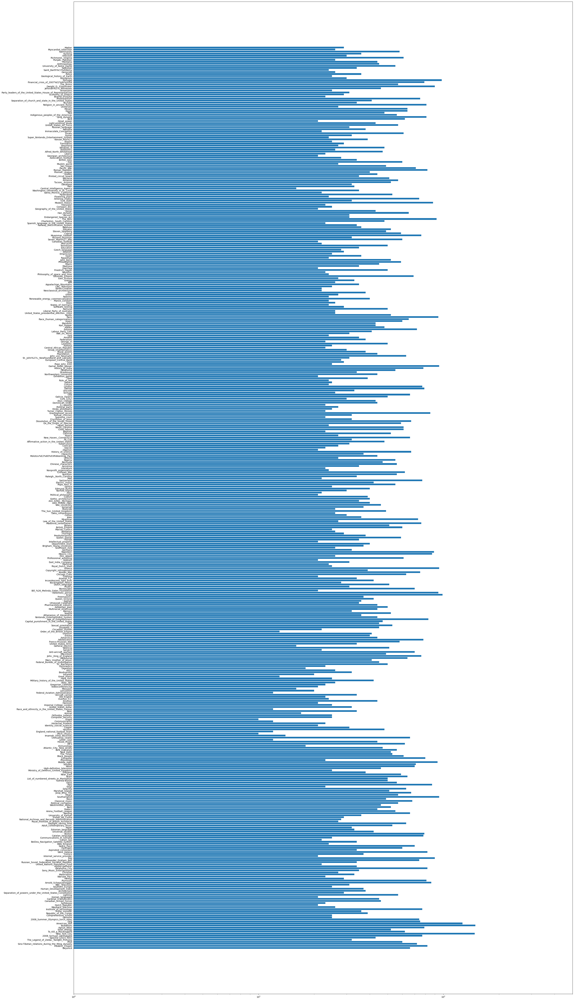

In [ ]:
from matplotlib import pyplot as plt


plt.figure(figsize = (40,80))
plt.barh(range(len(label_count)),label_count.values())
plt.yticks(range(len(label_count)),label_count.keys())
plt.xscale('log')
plt.xlim([1,500])
plt.show()

The plot shows how the number of contexts associated to a title changes with respect to the titles. Note that the x-axis is in logarithmic scale.

####Term frequencies

Here we compute the most frequent words for each title

In [ ]:
subjects = []

for i in range(len(flatten_contexts)):
  subjects.append('.'.join(map(str, flatten_contexts[i])))

In [ ]:
vocabs = []
vocabs_non_stopwords = []
punct_regex = '[' + string.punctuation + ']'
for s in range(len(subjects)):
  #iterates over the subjects

  #lowecase the string containing all contexts 
  lowercase = subjects[s].lower()

  #remove punctuation
  nopunctuation = re.sub(punct_regex,'', lowercase)
  
  #remove stopwords
  words = nopunctuation.split()
  non_stopwords = [w for w in words if w not in stopwords.words('english')]

  #here we create a vocabulary of the subject, both with and without the stopwords
  vocabs.append(set(words))
  vocabs_non_stopwords.append(set(non_stopwords))

  print(titles[s] + ':')
  print(nltk.Counter(non_stopwords).most_common(20))
  print('\n')


Beyoncé:
[('beyoncé', 157), ('album', 56), ('music', 49), ('first', 42), ('awards', 36), ('best', 36), ('single', 34), ('song', 32), ('million', 30), ('one', 29), ('love', 29), ('released', 29), ('beyoncés', 28), ('also', 28), ('artist', 26), ('2013', 26), ('us', 24), ('new', 23), ('child', 22), ('year', 22)]


Frédéric_Chopin:
[('chopin', 117), ('chopins', 59), ('piano', 54), ('music', 47), ('works', 38), ('op', 35), ('also', 34), ('paris', 32), ('polish', 29), ('warsaw', 28), ('sand', 23), ('two', 23), ('composer', 20), ('wrote', 20), ('concert', 20), ('many', 19), ('first', 19), ('musical', 16), ('liszt', 16), ('published', 16)]


Sino-Tibetan_relations_during_the_Ming_dynasty:
[('ming', 143), ('tibet', 124), ('tibetan', 85), ('emperor', 71), ('writes', 67), ('china', 64), ('dynasty', 56), ('chinese', 55), ('court', 53), ('lama', 53), ('mongol', 49), ('dalai', 45), ('states', 42), ('khan', 39), ('yongle', 34), ('also', 30), ('mongols', 30), ('yuan', 30), ('lamas', 29), ('titles', 28

> The same analysis performed on the single titles is quite more informative regarding the most common words of each subject. If we take as example the title "Frédéric_Chopin" we can observe that the most common words are 'chopin', 'piano', 'music'.

Vocabulary dimension for each title

In [ ]:
for s in range(len(vocabs_non_stopwords)):
  print(titles[s] + ': ' + str(len(vocabs_non_stopwords[s])))

Beyoncé: 2275
Frédéric_Chopin: 2514
Sino-Tibetan_relations_during_the_Ming_dynasty: 2160
IPod: 1575
The_Legend_of_Zelda:_Twilight_Princess: 1203
Spectre_(2015_film): 1670
2008_Sichuan_earthquake: 2049
New_York_City: 3527
To_Kill_a_Mockingbird: 2412
Solar_energy: 1538
Kanye_West: 2785
Buddhism: 2755
American_Idol: 2314
Dog: 1985
2008_Summer_Olympics_torch_relay: 2388
Genome: 572
Comprehensive_school: 663
Republic_of_the_Congo: 1056
Prime_minister: 698
Institute_of_technology: 1335
Wayback_Machine: 661
Dutch_Republic: 529
Symbiosis: 711
Canadian_Armed_Forces: 1192
Cardinal_(Catholicism): 1044
Iranian_languages: 573
Lighting: 1497
Separation_of_powers_under_the_United_States_Constitution: 857
Architecture: 1026
Human_Development_Index: 587
Southern_Europe: 569
BBC_Television: 811
Arnold_Schwarzenegger: 2379
Plymouth: 2197
Heresy: 913
Warsaw_Pact: 663
Materialism: 844
Christian: 707
Sony_Music_Entertainment: 697
Oklahoma_City: 1997
Hunter-gatherer: 971
United_Nations_Population_Fund: 550
R

###Question analysis

Here we analyse the questions contained in the database.

Average number of questions per context

In [ ]:
df_questions=df[['context','question']]
df_questions

,context,question
0,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce start becoming popular?
1,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,What areas did Beyonce compete in when she was...
2,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce leave Destiny's Child and bec...
3,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In what city and state did Beyonce grow up?
4,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In which decade did Beyonce become famous?
...,...,...
130314,"The term ""matter"" is used throughout physics i...",Physics has broadly agreed on the definition o...
130315,"The term ""matter"" is used throughout physics i...",Who coined the term partonic matter?
130316,"The term ""matter"" is used throughout physics i...",What is another name for anti-matter?
130317,"The term ""matter"" is used throughout physics i...",Matter usually does not need to be used in con...


In [ ]:
question_array=np.array(df_questions['question'].values).flatten()
question_array

array(['When did Beyonce start becoming popular?',
       'What areas did Beyonce compete in when she was growing up?',
       "When did Beyonce leave Destiny's Child and become a solo singer?",
       ..., 'What is another name for anti-matter?',
       'Matter usually does not need to be used in conjunction with what?',
       'What field of study has a variety of unusual contexts?'],
      dtype=object)

In [ ]:
print('Average number of question per context: ' + str(len(question_array)/len(context_array)))

Average number of question per context: 6.848441851910242


#### Vocabulary comparison
Another thing we can analyze is the differences in the vocabulary between questions and their corresponding contexts. Since in SQUaD2.0 there are many questions without an answer in the context, we think that such analysis may reveal some insight on this fact.

In [ ]:
#stemmer used to put verbs in base form and remove accent for better dictionary comparaison

from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize

stemmer = PorterStemmer()

In [ ]:
#We compute vocabulary differences only for the first context and relative questions, otherwhise it would require too much time and results would be not clear 

first_context=context_array[0]
questions=df_questions.loc[df_questions['context']==first_context]['question']
print(questions)

0              When did Beyonce start becoming popular?
1     What areas did Beyonce compete in when she was...
2     When did Beyonce leave Destiny's Child and bec...
3         In what city and state did Beyonce  grow up? 
4            In which decade did Beyonce become famous?
5            In what R&B group was she the lead singer?
6         What album made her a worldwide known artist?
7                Who managed the Destiny's Child group?
8                        When did Beyoncé rise to fame?
9        What role did Beyoncé have in Destiny's Child?
10    What was the first album Beyoncé released as a...
11        When did Beyoncé release Dangerously in Love?
12    How many Grammy awards did Beyoncé win for her...
13          What was Beyoncé's role in Destiny's Child?
14     What was the name of Beyoncé's first solo album?
Name: question, dtype: object


In [ ]:
first_context

'Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress. Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny\'s Child. Managed by her father, Mathew Knowles, the group became one of the world\'s best-selling girl groups of all time. Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".'

In [ ]:
#Punkt library for tokenization 
nltk.download('punkt')

#Context vocabulary extraction
lowercase_context = first_context.lower()
context_tokens = word_tokenize(lowercase_context)
context_stemmed_tokens = [stemmer.stem(token) for token in context_tokens]
stemmed_text = " ".join(context_stemmed_tokens)

words = stemmed_text.split()
vocab_context = set(words)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
#We do the same for the questions

vocab_questions_array=[]
for i in range(len(questions)):
  lowercase_question = questions[i].lower()
  questions_tokens = word_tokenize(lowercase_question)
  questions_stemmed_tokens = [stemmer.stem(token) for token in questions_tokens]
  stemmed_text = " ".join(questions_stemmed_tokens)

  words = stemmed_text.split()
  vocab_question = set(words)
  vocab_questions_array.append(vocab_question)

Finally we compute the difference between the context vocabulary and the questions one to see if they are similar or not

In [ ]:
difference_vocab=[]
for i in range(len(questions)):
  difference_vocab.append(vocab_questions_array[i]-vocab_context)
difference_vocab

[{'?', 'becom', 'beyonc', 'did', 'popular', 'start', 'when'},
 {'?', 'area', 'beyonc', 'compet', 'did', 'grow', 'up', 'wa', 'what', 'when'},
 {'?', 'becom', 'beyonc', 'did', 'leav', 'when'},
 {'?', 'beyonc', 'citi', 'did', 'grow', 'state', 'up', 'what'},
 {'?', 'becom', 'beyonc', 'decad', 'did', 'famou'},
 {'?', 'wa', 'what'},
 {'?', 'known', 'made', 'what'},
 {'?', 'who'},
 {'?', 'did', 'rise', 'when'},
 {'?', 'did', 'have', 'role', 'what'},
 {'?', 'first', 'wa', 'what'},
 {'?', 'did', 'when'},
 {'?', 'did', 'first', 'for', 'how', 'mani', 'win'},
 {'?', 'role', 'wa', 'what'},
 {'?', 'first', 'name', 'wa', 'what'}]

>This approach may be not the best one as it does not recognize all the words as the same one, for example in the first comparisons there is the word 'beyonc' as missmatch. Moreover, it does not perform any similarity comparison as it happens in word embeddings, hence the results may not be enough accurate. However, as a first attempt to compare the two vocabularies is quite interesting and for some of the questions it works fine. We can observe how most of the differences are in words like 'what', 'who', 'where', 'when', 'how', 'did', that are common incipits for questions.

###Clustering

####Kmeans algorithm for questions

Our objective is cluster all the questions to verify if there are some similarities even though they belong to very different topics



Import the TfidVectorizer to perform the Kmeans clustering algorithm

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_df = 0.8, min_df = 5,stop_words='english')
vectorizer.fit(question_array)

TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

Lenght of questions vocabulary

In [ ]:
vocab = vectorizer.get_feature_names_out()
print(f"lenght: {len(vocab)}")

lenght: 13519


We transform each question into a vector

In [ ]:
vector_questions = vectorizer.transform(question_array)
print(vector_questions[1])

  (0, 5699)	0.5345651060961141
  (0, 3794)	0.17464506928557696
  (0, 2819)	0.5463791384772317
  (0, 1685)	0.4513340065582507
  (0, 1115)	0.42603602979048744


The decimal values are the TF-IDF scores for the terms. We can sort the terms by their TF-IDF values, and print them out as follows:

In [ ]:
sorted([(vocab[j], vector_questions[1,j]) for j in vector_questions[1].nonzero()[1]], key = lambda x: -x[1])

[('compete', 0.5463791384772317),
 ('growing', 0.5345651060961141),
 ('beyonce', 0.4513340065582507),
 ('areas', 0.42603602979048744),
 ('did', 0.17464506928557696)]

We fit the Kmeans model with the vectors we computed before and we choose as number of clusters the number of titles. We have tried with other numbers but the results were not accurate: with few clusters, many of them were empty and just one very generic cluster contained all the vectors, while with other numbers, smaller than the now used k, the results were better but still not accurate as before.

In [ ]:
from sklearn.cluster import KMeans

k = len(set(df_context['title']))

kmeans = KMeans(n_clusters = k, max_iter=100, n_init=2, verbose=True, random_state=2307)
kmeans.fit(vector_questions)

Initialization complete
Iteration 0, inertia 127306.73856091539.
Iteration 1, inertia 121976.29740239882.
Iteration 2, inertia 117102.82802768421.
Iteration 3, inertia 114986.80894978084.
Iteration 4, inertia 114225.32754510964.
Iteration 5, inertia 113897.41871230587.
Iteration 6, inertia 113743.90316275766.
Iteration 7, inertia 113633.13239965762.
Iteration 8, inertia 113610.33899000956.
Iteration 9, inertia 113595.57113653343.
Iteration 10, inertia 113585.07941451034.
Iteration 11, inertia 113575.67871889466.
Iteration 12, inertia 113545.20283061011.
Iteration 13, inertia 113537.44992350892.
Iteration 14, inertia 113535.23829590152.
Iteration 15, inertia 113534.48628857636.
Iteration 16, inertia 113534.0811771978.
Iteration 17, inertia 113533.92485590573.
Iteration 18, inertia 113533.83654506461.
Iteration 19, inertia 113533.78379320935.
Iteration 20, inertia 113533.73784039158.
Iteration 21, inertia 113533.69036316904.
Iteration 22, inertia 113533.66382881207.
Iteration 23, inertia

KMeans(max_iter=100, n_clusters=442, n_init=2, random_state=2307, verbose=True)

In [ ]:
# Get the centroid for the first cluster
centroid = kmeans.cluster_centers_[0]

# Sort terms according to their weights 
# (argsort goes from lowest to highest, we reverse the order through slicing)
sorted_terms = centroid.argsort()[::-1]

# Print out the top 10 terms for the cluster
[vocab[j] for j in sorted_terms[:20]]

['schools',
 'comprehensive',
 'secondary',
 'students',
 'public',
 'did',
 'private',
 'grammar',
 'school',
 'uncomprehensive',
 'high',
 'state',
 'primary',
 'ireland',
 'type',
 'collapsed',
 'attend',
 'polytechnic',
 'catholic',
 'decade']

We can use our dot-product search to find the question in the collection that is the best exemplar of the cluster:

In [ ]:
index = np.argmax([np.dot(centroid,vec) for vec in vector_questions.toarray()])

print(question_array[index])

Why were the schools inspected?


We compute what is the cluster in which the first ten questions belong to


In [ ]:
for i in range(10): 
    print(f"document {i} is in cluster {kmeans.labels_[i]}")

document 0 is in cluster 4
document 1 is in cluster 58
document 2 is in cluster 413
document 3 is in cluster 235
document 4 is in cluster 58
document 5 is in cluster 152
document 6 is in cluster 248
document 7 is in cluster 413
document 8 is in cluster 58
document 9 is in cluster 413


Here we compute the top ten terms for each cluster

In [ ]:
print("Top terms per cluster:")
vocab = vectorizer.get_feature_names_out()

for i in range(kmeans.n_clusters):
    centroid = kmeans.cluster_centers_[i]    
    sorted_terms = centroid.argsort()[::-1]
    print(f"Cluster {i}:\t{[vocab[j] for j in sorted_terms[:10]]}")

Top terms per cluster:
Cluster 0:	['schools', 'comprehensive', 'secondary', 'students', 'public', 'did', 'private', 'grammar', 'school', 'uncomprehensive']
Cluster 1:	['destroy', 'did', 'does', 'karma', 'year', 'trying', 'reactor', 'pipes', 'midna', 'nuclear']
Cluster 2:	['tramway', 'aerial', 'starts', 'terminate', 'roosevelt', 'island', 'does', 'enlarged', 'enroll', 'enrichment']
Cluster 3:	['english', 'old', 'language', 'did', 'speak', 'speaking', 'modern', 'dominican', 'order', 'used']
Cluster 4:	['popular', 'music', 'sport', 'did', 'type', 'decade', 'sports', 'dance', 'drink', 'game']
Cluster 5:	['rank', 'does', 'terms', 'miami', 'cities', 'world', 'did', 'states', 'population', 'oklahoma']
Cluster 6:	['comcast', 'did', 'buy', 'company', 'pay', '2004', 'warner', 'purchase', 'customer', 'customers']
Cluster 7:	['department', 'store', 'defense', 'did', 'located', 'state', 'opened', 'companies', 'departments', 'paris']
Cluster 8:	['host', 'did', 'year', 'olympics', 'does', 'cup', 'cit



> We can see how vocabs in the same cluster are quite relaten one to another.



Here we compute the number of documents for each cluster

In [ ]:
print('Number of docs in: ')

for i in range(kmeans.n_clusters):
    print(f"Cluster {i}: {np.sum(kmeans.labels_ == i)}")

Number of docs in: 
Cluster 0: 316
Cluster 1: 77
Cluster 2: 1
Cluster 3: 383
Cluster 4: 331
Cluster 5: 241
Cluster 6: 148
Cluster 7: 147
Cluster 8: 130
Cluster 9: 1
Cluster 10: 301
Cluster 11: 4
Cluster 12: 328
Cluster 13: 186
Cluster 14: 303
Cluster 15: 363
Cluster 16: 65
Cluster 17: 184
Cluster 18: 1
Cluster 19: 273
Cluster 20: 446
Cluster 21: 272
Cluster 22: 127
Cluster 23: 390
Cluster 24: 222
Cluster 25: 132
Cluster 26: 1
Cluster 27: 86
Cluster 28: 31
Cluster 29: 179
Cluster 30: 174
Cluster 31: 306
Cluster 32: 155
Cluster 33: 102
Cluster 34: 502
Cluster 35: 55
Cluster 36: 211
Cluster 37: 1
Cluster 38: 99
Cluster 39: 254
Cluster 40: 347
Cluster 41: 480
Cluster 42: 44
Cluster 43: 559
Cluster 44: 2
Cluster 45: 2
Cluster 46: 499
Cluster 47: 1
Cluster 48: 318
Cluster 49: 20
Cluster 50: 1
Cluster 51: 58
Cluster 52: 4
Cluster 53: 1
Cluster 54: 99
Cluster 55: 19
Cluster 56: 2
Cluster 57: 113
Cluster 58: 47804
Cluster 59: 449
Cluster 60: 12
Cluster 61: 370
Cluster 62: 15
Cluster 63: 170
Clu



> It is interesting to see the differences in the dimension of the clusters, from 1 document to nearly 5000, this explains the variety of our dataset.



Finally we evaluate the algorithm performances, we used two metrics:

- Sum-of-squares: measures the sum of squared distances between each data point and its assigned cluster center. A lower SSE indicates that the data points are closer to their cluster centers and that the clustering is more compact
- Silouette coefficient: it measures the degree of similarity of each data point to its own cluster compared to other clusters. It ranges from -1 to 1, with higher values indicating better cluster separation

In [ ]:
#kmeans clustering evaluation
from sklearn import metrics

print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_questions, kmeans.labels_)))

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 113533.62145566792
Silhouette coefficient: 0.019296621353191316




> Given our dataset, it is not unexpected that the evaluation metrics for the clustering are not that good.



####Clustering with MiniBatchKmeans

We repeat the same operations as we did for the Kmeans algorithm but using the MiniBatchKMeans algorithm.

In [ ]:
from sklearn.cluster import MiniBatchKMeans

k = len(set(df_context['title']))

mb_kmeans = MiniBatchKMeans(n_clusters = k, batch_size = 500, random_state = 2307)
mb_kmeans.fit(vector_questions)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


MiniBatchKMeans(batch_size=500, n_clusters=442, random_state=2307)

In [ ]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(mb_kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_questions, mb_kmeans.labels_)))
print("\n")

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 118029.8484698153
Silhouette coefficient: -0.03030502989298996






> This other version of k-means was even worse than the previous one.



We compute the performance evaluation measure values across the range of k values and we plot it:

In [ ]:
performance = [MiniBatchKMeans(n_clusters=k, batch_size=500, random_state=2307).fit(vector_questions).inertia_ for k in range(1,50)]
performance

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


[129479.68709433549,
 128904.6772929584,
 128662.63996350238,
 129484.68922120954,
 128660.71886646663,
 128423.76143080815,
 128212.1517002577,
 128754.70684441994,
 127794.71945315044,
 127816.56329230443,
 129471.94647583214,
 127452.10075496565,
 127526.35514636291,
 129224.8210796983,
 128210.95607425825,
 127071.85506548999,
 127345.80956278084,
 127574.49796237436,
 127141.28535698223,
 127444.71439739058,
 127549.1199199523,
 129436.8362719898,
 127438.65683733986,
 127064.48895187581,
 127023.14759350536,
 127203.23234500097,
 127329.26068514073,
 129417.1967430232,
 128933.87541214851,
 129398.10316195135,
 127137.2822980359,
 129417.5117466881,
 129420.22326247342,
 126990.92032751936,
 129370.78344876284,
 126209.35769831628,
 129425.2833579098,
 129340.09402014827,
 129238.10755265172,
 126333.6747723082,
 129413.74671154417,
 129370.04557431725,
 129423.14813381783,
 129295.15054140743,
 129248.20966558825,
 129363.88038332702,
 126785.54855295489,
 126136.14135823952,
 1

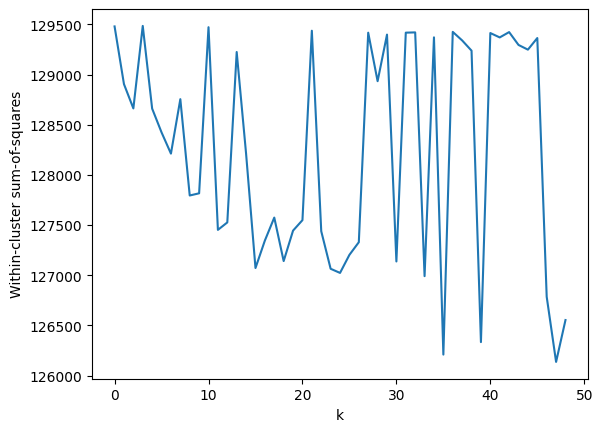

In [ ]:
plt.figure()
plt.plot(performance)
plt.ylabel('Within-cluster sum-of-squares')
plt.xlabel('k')
plt.show()

>The graph doesn't look good. Probably the problem is that we have very high dimensional data. We'll try to transform these data into low dimensional data (just 3 dimensions) using a linear dimensionality reduction technique called Singular Value Decomposition.

In [ ]:
from sklearn.decomposition import TruncatedSVD

svd = TruncatedSVD(3)
reduced_data = svd.fit_transform(vector_questions)

[x,y,z] = np.transpose(reduced_data)
[x,y,z]

[array([0.24254505, 0.16573065, 0.13403927, ..., 0.00340946, 0.03048469,
        0.00930794]),
 array([-0.02713428, -0.01806589, -0.01626454, ...,  0.00367912,
         0.22736362,  0.00428552]),
 array([-0.06951617, -0.05553797, -0.04398093, ..., -0.00145956,
         0.01094062, -0.0004951 ])]

We plot the results

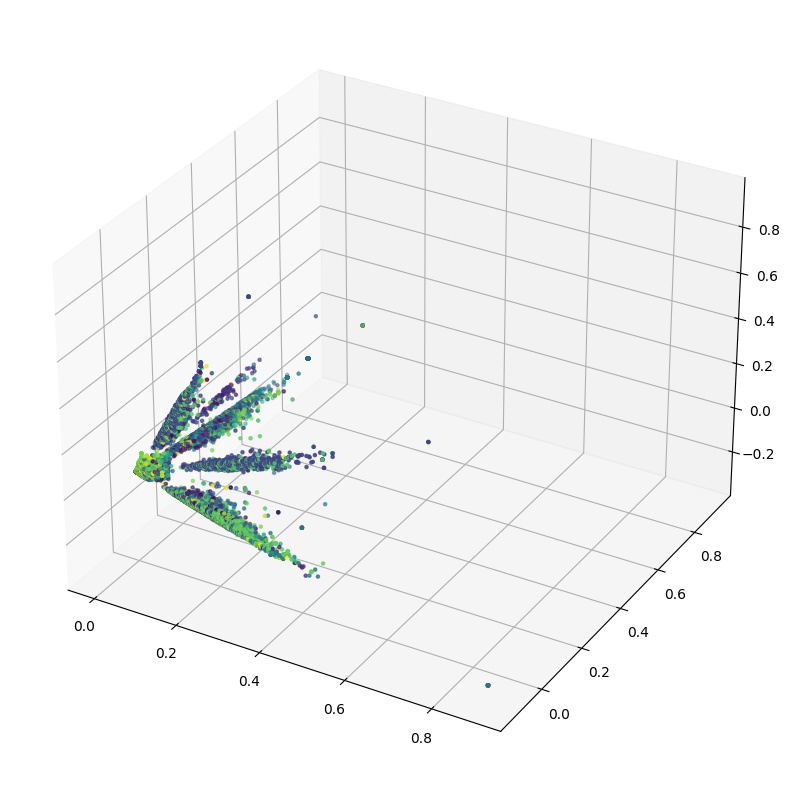

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import LabelEncoder

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=LabelEncoder().fit_transform(question_array), marker='.');

Here we plot the results using the clusters we found in the KMeans algorithm

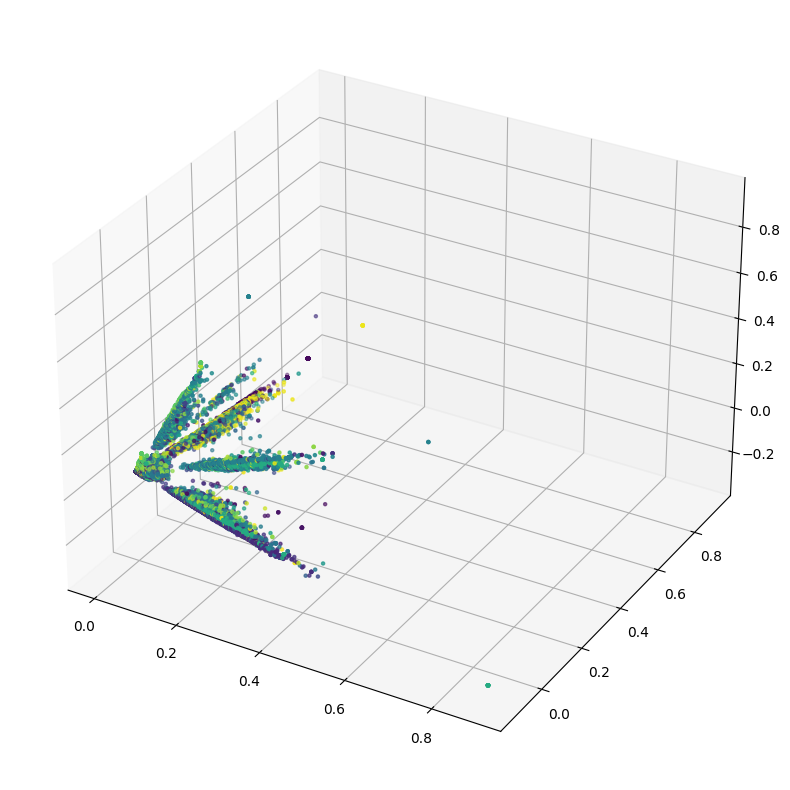

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=kmeans.labels_, marker='.');



> in the first plot we didn't use the clusters provided by k-means and in fact the colors are spread almost evenly, in the second plot, we used those clusters and at least we can see some pattern in the data.



####LDA clustering on contexts




LDA (Latent Dirichlet Allocation) is a topic modeling algorithm that is often used for text data analysis, particularly for clustering and categorization of documents based on their content. 
It can be a useful method for clustering multiple texts of different types based on their topic distributions. Thus, we use it to cluster the contexts of our dataset based on their topics.

In [ ]:
from sklearn.model_selection import train_test_split

contexts_train, contexts_test, label_train, label_test = train_test_split(context_array, df_context['title'], test_size=0.4)
print('No. training docs:', len(contexts_train))
print('No. testing docs:', len(contexts_test))

No. training docs: 11417
No. testing docs: 7612


As in the previous algorithms, here also we perform the vectorization of the contexts

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(stop_words='english',min_df=5,max_df=.5)
vector_contexts_train = vectorizer.fit_transform(contexts_train)

We compute the vectorized context vocabulary

In [ ]:
vocab = vectorizer.get_feature_names_out()
len(vocab)

15350

We run the LDA algorithm choosing 20 as number of "clusters". As before we tried different numbers and we took 20 because it gave the best results as we will see in the plot.

In [ ]:
#topic extraction with LDA

from sklearn.decomposition import LatentDirichletAllocation

lda = LatentDirichletAllocation(n_components=20, verbose=1, learning_method='online', max_iter=30)
lda.fit(vector_contexts_train)

iteration: 1 of max_iter: 30
iteration: 2 of max_iter: 30
iteration: 3 of max_iter: 30
iteration: 4 of max_iter: 30
iteration: 5 of max_iter: 30
iteration: 6 of max_iter: 30
iteration: 7 of max_iter: 30
iteration: 8 of max_iter: 30
iteration: 9 of max_iter: 30
iteration: 10 of max_iter: 30
iteration: 11 of max_iter: 30
iteration: 12 of max_iter: 30
iteration: 13 of max_iter: 30
iteration: 14 of max_iter: 30
iteration: 15 of max_iter: 30
iteration: 16 of max_iter: 30
iteration: 17 of max_iter: 30
iteration: 18 of max_iter: 30
iteration: 19 of max_iter: 30
iteration: 20 of max_iter: 30
iteration: 21 of max_iter: 30
iteration: 22 of max_iter: 30
iteration: 23 of max_iter: 30
iteration: 24 of max_iter: 30
iteration: 25 of max_iter: 30
iteration: 26 of max_iter: 30
iteration: 27 of max_iter: 30
iteration: 28 of max_iter: 30
iteration: 29 of max_iter: 30
iteration: 30 of max_iter: 30


LatentDirichletAllocation(learning_method='online', max_iter=30,
                          n_components=20, verbose=1)

Here we evaluate our model using the perplexity metric using the test set. 

Perplexity is a statistical measure of how confidently a language model predicts a text sample. In other words, it quantifies how “surprised” the model is when it sees new data. The lower the perplexity, the better the model predicts the text

In [ ]:
vector_contexts_test = vectorizer.transform(contexts_test)
lda.perplexity(vector_contexts_test)

6706.43931560602



> Hence it is not so good, but it was the best we obtained.



printing the top terms for each topic

In [ ]:
import numpy as np

for i in range(len(lda.components_)):
    sorted_terms = lda.components_[i].argsort()[::-1]
    concatenated_terms = '[' + ', '.join(vocab[i] for i in sorted_terms[:10]) + ']'
    print (f'Topic {i + 1}:\t', concatenated_terms)

Topic 1:	 [war, french, british, military, army, france, german, forces, soviet, germany]
Topic 2:	 [human, social, scientific, theory, self, philosophy, copper, sexual, identity, science]
Topic 3:	 [power, used, use, group, data, using, electric, current, based, speed]
Topic 4:	 [university, school, education, college, schools, students, public, program, research, universities]
Topic 5:	 [new, american, year, time, united, states, september, president, second, 2007]
Topic 6:	 [company, energy, water, food, production, oil, plant, used, products, cells]
Topic 7:	 [term, used, time, use, study, different, called, example, systems, information]
Topic 8:	 [empire, east, south, north, region, india, eastern, southern, west, africa]
Topic 9:	 [health, needed, citation, paper, von, cyprus, care, technical, safety, lee]
Topic 10:	 [century, people, early, new, european, culture, women, period, chinese, children]
Topic 11:	 [state, government, states, law, united, federal, members, church, cou

plotting the top terms for each topic based to the weight the algorithm assigned to them

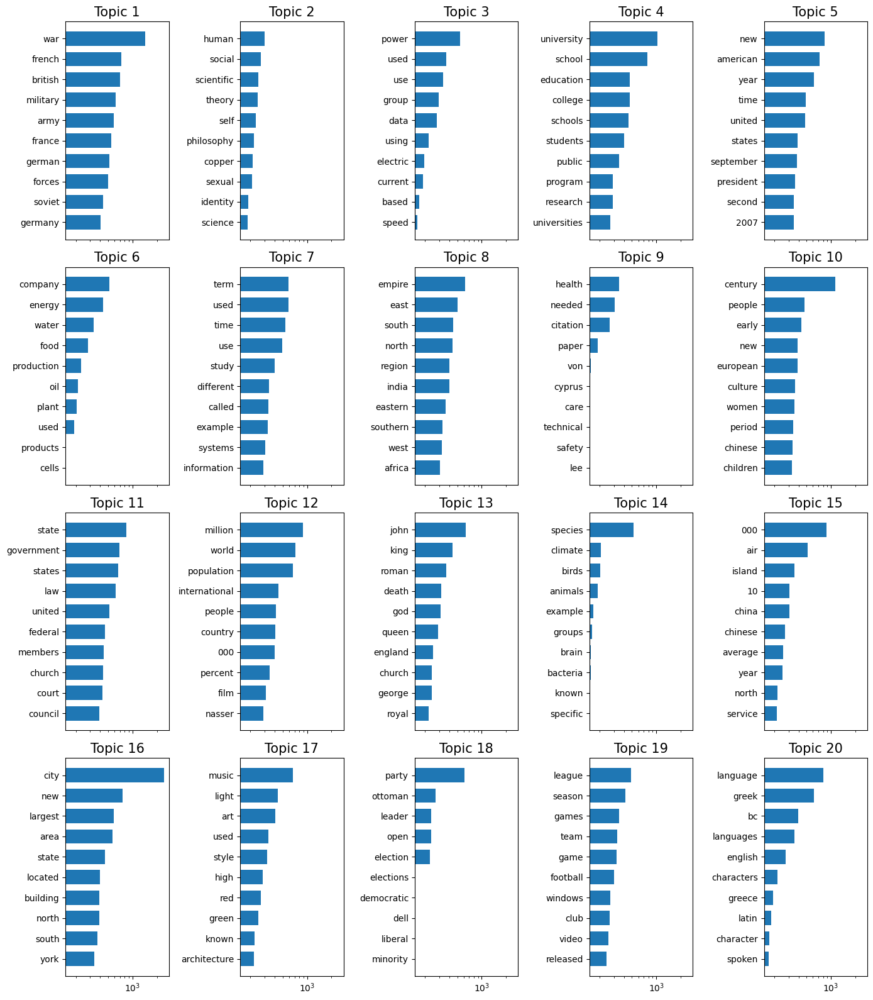

In [ ]:
num_words = 10
cols = 5
rows = int(len(lda.components_)/5)

fig, axes = plt.subplots(rows, cols, figsize=(14, 4 * rows), sharex=True)
axes = axes.flatten()
for topic_idx, topic in enumerate(lda.components_):
    top_terms_index = topic.argsort()[:-num_words - 1:-1]
    top_terms = [vocab[i] for i in top_terms_index]
    weights = topic[top_terms_index]
    ax = axes[topic_idx]
    ax.barh(top_terms, weights, height=0.7)
    ax.set_title(f'Topic {topic_idx +1}',fontdict={'fontsize': 15})
    ax.invert_yaxis()
    ax.set_xscale('log')

plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
plt.tight_layout()
plt.show()

>As we can see no topic is empty so we chose a good number of components for the algorithm. Choosing other numbers resulted in empty topics.

### Keyword search

we install python-terrier package 

In [ ]:
!pip install -q python-terrier

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.4/104.4 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 59.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.5/311.5 kB 33.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 33.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 72.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━

Import pyterrier library to index our document and perform text search over the contexts

In [ ]:
import pyterrier as pt
if not pt.started():
  pt.init()

terrier-assemblies 5.7 jar-with-dependencies not found, downloading to /root/.pyterrier...
Done
terrier-python-helper 0.0.7 jar not found, downloading to /root/.pyterrier...
Done


PyTerrier 0.9.2 has loaded Terrier 5.7 (built by craigm on 2022-11-10 18:30) and terrier-helper 0.0.7



Pyterrier requires as input the text and a docno column so here we compute the document in the correct format to perfom the text search

In [ ]:
docs_df = pd.DataFrame([["c0",context_array[0]]],columns = ["docno","context"])

for i in range(len(context_array)):
  docs_df = docs_df.append({'docno' : 'c'+ str(i + 1), 'context' : context_array[i]},
        ignore_index = True)


docs_df = docs_df.iloc[1:, :]
  
docs_df

Output streaming troncato alle ultime 5000 righe.
<ipython-input-64-a5584bc5fb4c>:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  docs_df = docs_df.append({'docno' : 'c'+ str(i + 1), 'context' : context_array[i]},
<ipython-input-64-a5584bc5fb4c>:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  docs_df = docs_df.append({'docno' : 'c'+ str(i + 1), 'context' : context_array[i]},
<ipython-input-64-a5584bc5fb4c>:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  docs_df = docs_df.append({'docno' : 'c'+ str(i + 1), 'context' : context_array[i]},
<ipython-input-64-a5584bc5fb4c>:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  docs_df = docs_df.

,docno,context
1,c1,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...
2,c2,Following the disbandment of Destiny's Child i...
3,c3,"A self-described ""modern-day feminist"", Beyonc..."
4,c4,"Beyoncé Giselle Knowles was born in Houston, T..."
5,c5,Beyoncé attended St. Mary's Elementary School ...
...,...,...
19025,c19025,Isaac Newton (1643–1727) inherited Descartes' ...
19026,c19026,"There is an entire literature concerning the ""..."
19027,c19027,In the late 19th century with the discovery of...
19028,c19028,These quarks and leptons interact through four...


Index creation over the document

In [ ]:
indexer = pt.DFIndexer("./index_search", overwrite=True)
index_ref = indexer.index(docs_df["context"], docs_df["docno"])
index_ref.toString()

/usr/local/lib/python3.10/dist-packages/pyterrier/index.py:628: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column, value in meta_column[1].iteritems():


'./index_search/data.properties'

move in the correct folder

In [ ]:
!ls -lh index_search/

total 9.2M
-rw------- 1 root root 1.7M May 26 19:50 data.direct.bf
-rw------- 1 root root 316K May 26 19:50 data.document.fsarrayfile
-rw------- 1 root root 1.4M May 26 19:50 data.inverted.bf
-rw------- 1 root root 4.7M May 26 19:50 data.lexicon.fsomapfile
-rw------- 1 root root 1017 May 26 19:50 data.lexicon.fsomaphash
-rw------- 1 root root 220K May 26 19:50 data.lexicon.fsomapid
-rw------- 1 root root 428K May 26 19:50 data.meta-0.fsomapfile
-rw------- 1 root root 149K May 26 19:50 data.meta.idx
-rw------- 1 root root 398K May 26 19:50 data.meta.zdata
-rw------- 1 root root 4.2K May 26 19:50 data.properties


In [ ]:
index = pt.IndexFactory.of(index_ref)

We compute some document statistics:

- Nt is the number of unique documents(contexts) that each term occurs in, this is useful for calculating IDF.

- TF is the total number of occurrences of term in corpus


In [ ]:
print(index.getCollectionStatistics().toString())

Number of documents: 19029
Number of terms: 56194
Number of postings: 991498
Number of fields: 0
Number of tokens: 1284468
Field names: []
Positions:   false



In [ ]:
for kv in index.getLexicon():
    print(kv.getKey(),": ", kv.getValue().toString())

Output streaming troncato alle ultime 5000 righe.
trioxid :  term29018 Nt=1 TF=1 maxTF=1 @{0 1323068 6}
trip :  term2040 Nt=66 TF=71 maxTF=2 @{0 1323072 0}
tripadvisor :  term42185 Nt=1 TF=1 maxTF=1 @{0 1323197 1}
triparadisu :  term31328 Nt=1 TF=1 maxTF=1 @{0 1323200 5}
tripartit :  term10695 Nt=14 TF=19 maxTF=2 @{0 1323203 7}
triped :  term44970 Nt=2 TF=4 maxTF=3 @{0 1323231 4}
tripi :  term9229 Nt=1 TF=1 maxTF=1 @{0 1323236 6}
tripitaka :  term9233 Nt=1 TF=1 maxTF=1 @{0 1323239 2}
tripl :  term2849 Nt=39 TF=46 maxTF=4 @{0 1323241 6}
triplet :  term15348 Nt=2 TF=2 maxTF=1 @{0 1323323 1}
triploblast :  term24791 Nt=3 TF=3 maxTF=1 @{0 1323329 3}
triploid :  term10560 Nt=3 TF=5 maxTF=2 @{0 1323336 3}
tripod :  term27746 Nt=1 TF=1 maxTF=1 @{0 1323345 7}
tripoli :  term25641 Nt=14 TF=18 maxTF=2 @{0 1323349 1}
tripolitsa :  term33044 Nt=1 TF=1 maxTF=1 @{0 1323365 7}
tripper :  term32636 Nt=1 TF=1 maxTF=1 @{0 1323369 3}
trippin :  term26131 Nt=1 TF=1 maxTF=1 @{0 1323372 7}
triptych :  term2

Here we compute some statistics for a specific term

In [ ]:
index.getLexicon()["beyonc"].toString()

'term24 Nt=73 TF=218 maxTF=8 @{0 216496 1}'



> So, Beyoncè appears in 73 contexts for a total of 218 times.



Here we used the TF-IDF weighting formula to rank the results. 

The `search()` method returns a dataframe with columns:
 - `qid`: the query identifier
 - `docid`: integer identifier for document 
 - `docno`: string identifier for document
 - `rank`: rank position
 - `score`: tf-idf score
 - `query`: the input query

In [ ]:
query = "beyonc"

br = pt.BatchRetrieve(index, wmodel="TF_IDF")
br.search(query)

,qid,docid,docno,rank,score,query
0,1,35,c36,0,7.825124,beyonc
1,1,50,c51,1,7.766572,beyonc
2,1,55,c56,2,7.659294,beyonc
3,1,26,c27,3,7.633009,beyonc
4,1,56,c57,4,7.584953,beyonc
...,...,...,...,...,...,...
68,1,2104,c2105,68,4.214855,beyonc
69,1,2,c3,69,3.697432,beyonc
70,1,750,c751,70,3.605227,beyonc
71,1,8,c9,71,3.401639,beyonc


In [ ]:
context_array[35]

"Beyoncé's music is generally R&B, but she also incorporates pop, soul and funk into her songs. 4 demonstrated Beyoncé's exploration of 90s-style R&B, as well as further use of soul and hip hop than compared to previous releases. While she almost exclusively releases English songs, Beyoncé recorded several Spanish songs for Irreemplazable (re-recordings of songs from B'Day for a Spanish-language audience), and the re-release of B'Day. To record these, Beyoncé was coached phonetically by American record producer Rudy Perez."

same but we use BM25 to compare results

In [ ]:
query = "beyonc"

br = pt.BatchRetrieve(index, wmodel="BM25")
br.search(query)

,qid,docid,docno,rank,score,query
0,1,35,c36,0,14.308766,beyonc
1,1,50,c51,1,14.201701,beyonc
2,1,55,c56,2,14.005536,beyonc
3,1,26,c27,3,13.957472,beyonc
4,1,56,c57,4,13.869598,beyonc
...,...,...,...,...,...,...
68,1,2104,c2105,68,7.707146,beyonc
69,1,2,c3,69,6.761004,beyonc
70,1,750,c751,70,6.592401,beyonc
71,1,8,c9,71,6.220126,beyonc


### Word embeddings (word2vec)

####Similarities between contexts

Fist of all, we have to prepare the data for Word2Vec algorithm

>We prepare an array of sentences for each context

In [ ]:
import re
from pandas.core.common import flatten
from gensim.models.word2vec import Word2Vec

docs = [re.sub('\n', ' ', context) for context in context_array]

docs = [re.sub('[a-zA-Z0-9._%+-]+@[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}', '', doc) for doc in docs]

context_sentences = [re.split('[?!.]\s', doc) for doc in docs]

context_sentences[:2]

[['Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress',
  "Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny's Child",
  "Managed by her father, Mathew Knowles, the group became one of the world's best-selling girl groups of all time",
  'Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".'],
 ['Following the disbandment of Destiny\'s Child in June 2005, she released her second solo album, B\'Day (2006), which contained hits "Déjà Vu", "Irreplaceable", and "Beautiful Liar"',
  'Beyoncé also ventured into acting, with a Golden Globe-nominated performance in Dreamgirls (2006)

>We join all the sentences in a unique variable

In [ ]:
context_sentences = list(flatten(context_sentences))

context_sentences[:10]

['Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress',
 "Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny's Child",
 "Managed by her father, Mathew Knowles, the group became one of the world's best-selling girl groups of all time",
 'Their hiatus saw the release of Beyoncé\'s debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".',
 'Following the disbandment of Destiny\'s Child in June 2005, she released her second solo album, B\'Day (2006), which contained hits "Déjà Vu", "Irreplaceable", and "Beautiful Liar"',
 'Beyoncé also ventured into acting, with a Golden Globe-nominated performance in Dreamgirls (2006), and s

>We remove any non-alphanumeric characters and perfom the split operation the obtain each word from each sentence

In [ ]:
tokenized_context_sentences = [re.sub('\W', ' ', context_sentence).lower().split() for context_sentence in context_sentences]
# remove sentences that are only 1 word long
tokenized_context_sentences = [context_sentence for context_sentence in tokenized_context_sentences if len(context_sentence) > 1]

for sentence in tokenized_context_sentences[:30] :
  print(sentence)

['beyoncé', 'giselle', 'knowles', 'carter', 'biːˈjɒnseɪ', 'bee', 'yon', 'say', 'born', 'september', '4', '1981', 'is', 'an', 'american', 'singer', 'songwriter', 'record', 'producer', 'and', 'actress']
['born', 'and', 'raised', 'in', 'houston', 'texas', 'she', 'performed', 'in', 'various', 'singing', 'and', 'dancing', 'competitions', 'as', 'a', 'child', 'and', 'rose', 'to', 'fame', 'in', 'the', 'late', '1990s', 'as', 'lead', 'singer', 'of', 'r', 'b', 'girl', 'group', 'destiny', 's', 'child']
['managed', 'by', 'her', 'father', 'mathew', 'knowles', 'the', 'group', 'became', 'one', 'of', 'the', 'world', 's', 'best', 'selling', 'girl', 'groups', 'of', 'all', 'time']
['their', 'hiatus', 'saw', 'the', 'release', 'of', 'beyoncé', 's', 'debut', 'album', 'dangerously', 'in', 'love', '2003', 'which', 'established', 'her', 'as', 'a', 'solo', 'artist', 'worldwide', 'earned', 'five', 'grammy', 'awards', 'and', 'featured', 'the', 'billboard', 'hot', '100', 'number', 'one', 'singles', 'crazy', 'in', '

We now can run the model with the data in the correct format

In [ ]:
model = Word2Vec(tokenized_context_sentences, vector_size = 30, min_count = 5, window = 10)

We can try the model

In [ ]:
term = 'god'

model.wv.most_similar(term)

[('spirit', 0.8947249054908752),
 ('divine', 0.8809859752655029),
 ('conception', 0.8775847554206848),
 ('faith', 0.8712193369865417),
 ('jesus', 0.8605262041091919),
 ('doctrine', 0.8512300252914429),
 ('christ', 0.844329297542572),
 ('mind', 0.8151885867118835),
 ('belief', 0.806840181350708),
 ('truth', 0.8032397627830505)]



> It seems that the embedded space is well-formed



Now we randomly take 3000 token and we plot them to see if similar words are close in the plot.

In [ ]:
import random

sample = random.sample(list(model.wv.key_to_index),3000)

In [ ]:
word_vectors = model.wv[sample]

We use the TSNE library to reduce data dimension and we set it to 3

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components = 3,n_iter = 2000)
tsne_embedding = tsne.fit_transform(word_vectors)

In [ ]:
import numpy as np

x,y,z = np.transpose(tsne_embedding)

In [ ]:
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import plotly.express as px

fig = px.scatter_3d(x=x[:200],y=y[:200],z=z[:200],text=sample[:200])
fig.update_traces(marker=dict(size=3,line=dict(width=2)),textfont_size=10)
fig.show()



> Given the randomness of the process and the small number of examples taken it isn't always possible to have visual results in this plot, but with patience some lucky try could be interesting. 



####Similarities between a context and related questions

In this section, we try to compute the similarity score, using the cosine similarity, between each question and the context it refers to. To simplify the process we performed the similarity computation only for the fist context and its related questions.

This represents a second and better approach to perform the vocabulary comparison between context and questions.

Firstly, we tokenize the context and the questions

In [ ]:
from gensim.models import Word2Vec
from gensim.utils import simple_preprocess
from sklearn.metrics.pairwise import cosine_similarity
# Tokenize the context and questions
tokenized_context = simple_preprocess(first_context)
tokenized_questions = [simple_preprocess(question) for question in questions]
print(tokenized_context)
print(tokenized_questions)

['beyoncé', 'giselle', 'knowles', 'carter', 'biːˈjɒnseɪ', 'bee', 'yon', 'say', 'born', 'september', 'is', 'an', 'american', 'singer', 'songwriter', 'record', 'producer', 'and', 'actress', 'born', 'and', 'raised', 'in', 'houston', 'texas', 'she', 'performed', 'in', 'various', 'singing', 'and', 'dancing', 'competitions', 'as', 'child', 'and', 'rose', 'to', 'fame', 'in', 'the', 'late', 'as', 'lead', 'singer', 'of', 'girl', 'group', 'destiny', 'child', 'managed', 'by', 'her', 'father', 'mathew', 'knowles', 'the', 'group', 'became', 'one', 'of', 'the', 'world', 'best', 'selling', 'girl', 'groups', 'of', 'all', 'time', 'their', 'hiatus', 'saw', 'the', 'release', 'of', 'beyoncé', 'debut', 'album', 'dangerously', 'in', 'love', 'which', 'established', 'her', 'as', 'solo', 'artist', 'worldwide', 'earned', 'five', 'grammy', 'awards', 'and', 'featured', 'the', 'billboard', 'hot', 'number', 'one', 'singles', 'crazy', 'in', 'love', 'and', 'baby', 'boy']
[['when', 'did', 'beyonce', 'start', 'becoming

In [ ]:
# Train the Word2Vec model
model = Word2Vec(tokenized_context + tokenized_questions, min_count=1)


Then, we compute the word embeddings vectors of the context and of the questions

In [ ]:
import numpy as np

# Compute the context vector
context_vector = None
context_words = [word for word in tokenized_context if word in model.wv.key_to_index]
if context_words:
    context_vector = np.mean([model.wv[word] for word in context_words], axis=0)

# Compute the question vectors
question_vectors = []
for question in tokenized_questions:
    question_words = [word for word in question if word in model.wv.key_to_index]
    if question_words:
        question_vector = np.mean([model.wv[word] for word in question_words], axis=0)
        question_vectors.append(question_vector)


In [ ]:
print(context_vector)
print(question_vectors)

[-2.0407913e-03 -1.9340653e-03 -1.0914179e-04 -4.6494580e-04
  1.9096941e-04 -4.6479479e-05 -2.0450533e-03  6.1985396e-04
  7.4900145e-04  3.7834444e-04  3.2866341e-05 -1.6878765e-03
  9.7371807e-04  1.8014599e-03  5.7601911e-04 -2.8130773e-03
  5.9352256e-04 -1.4145346e-03  8.2582183e-04 -7.3237106e-04
  2.2064981e-03 -2.1301247e-03  7.8567302e-07 -1.5389235e-04
  2.8442270e-03  1.5370253e-03  8.7213534e-04  5.6093745e-04
  1.0684821e-03  1.5538812e-03  5.8221386e-04  1.8847197e-03
  8.6724682e-04 -3.0683388e-03  2.8352933e-03 -1.6918087e-04
 -3.1308128e-04 -1.7999874e-03  8.6975703e-04 -6.7366916e-04
 -6.9338613e-04 -1.2390553e-03  1.0060858e-03 -9.7723526e-04
  7.5853245e-06 -2.3029374e-03 -1.3865355e-03  2.3979627e-04
  1.4600649e-03 -1.3992785e-03  2.1088796e-03  3.1377171e-05
  4.1859166e-04  2.2745931e-03 -2.1257012e-03  8.0006028e-04
  8.1013684e-05  1.0152980e-03 -2.5255274e-04  5.5751763e-04
  6.6639314e-04 -5.1224738e-04 -5.1236566e-04  2.2403824e-03
 -2.5527264e-04  7.84783

Finally, we compute the cosine similarity between each question and the context and we sort them

In [ ]:
similarities = [cosine_similarity([context_vector], [qv])[0][0] for qv in question_vectors]

In [ ]:
sorted_questions = [question for _, question in sorted(zip(similarities, questions), reverse=True)]
sorted_questions

['In what R&B group was she the lead singer?',
 "When did Beyonce leave Destiny's Child and become a solo singer?",
 "Who managed the Destiny's Child group?",
 "What was the name of Beyoncé's first solo album?",
 "What role did Beyoncé have in Destiny's Child?",
 "What was Beyoncé's role in Destiny's Child?",
 'What was the first album Beyoncé released as a solo artist?',
 'In what city and state did Beyonce  grow up? ',
 'When did Beyoncé release Dangerously in Love?',
 'What album made her a worldwide known artist?',
 'How many Grammy awards did Beyoncé win for her first solo album?',
 'When did Beyoncé rise to fame?',
 'In which decade did Beyonce become famous?',
 'What areas did Beyonce compete in when she was growing up?',
 'When did Beyonce start becoming popular?']

Below the plot showing the result

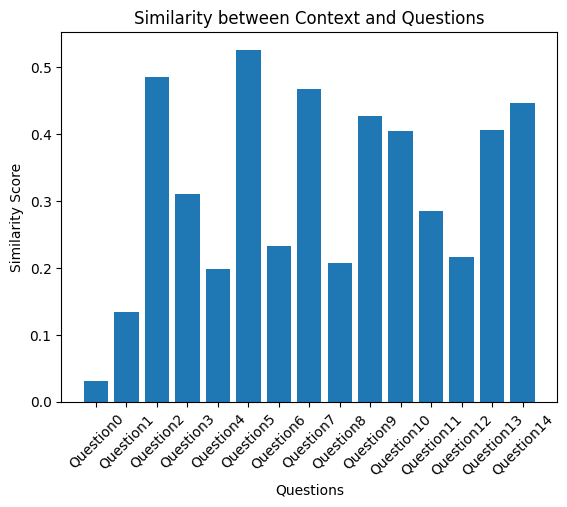

In [ ]:
import matplotlib.pyplot as plt

# Compute the similarities (assuming you have already calculated them)
question_labels = ["Question"+str(i) for i in range(len(questions))]  # Replace with your question labels

# Create a bar plot
plt.bar(question_labels, similarities)
plt.xlabel("Questions")
plt.ylabel("Similarity Score")
plt.title("Similarity between Context and Questions")

# Rotate the x-axis labels for better readability if needed
plt.xticks(rotation=45)

# Display the plot
plt.show()


>As we can see, the first question has the lowest similarity score, while the fifth one has the highest score. 

##Generative QA

In this section, we train a model to output the answer to a question given the context and the question. We also compare the output of the model with the true output, which is the answer to the question in the data set. 



In [ ]:
import json
import pandas as pd
import numpy as np

In [ ]:
!pip -q install transformers sentencepiece accelerate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 96.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 73.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.1/219.1 kB 27.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 26.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 85.3 MB/s eta 0:00:00


We use the pre-trained answering model [FLAN T5](https://arxiv.org/abs/2210.11416)

In [ ]:
import torch
from transformers import T5Tokenizer, T5ForConditionalGeneration

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

tokenizer = T5Tokenizer.from_pretrained("google/flan-t5-large")
model = T5ForConditionalGeneration.from_pretrained("google/flan-t5-large", device_map="auto", torch_dtype=torch.float32)


Here we prepare the data to be fed to the question answering pipeline

In [ ]:
import numpy as np
target_context=[]
context_array=np.array(df_context['context'].values).flatten()
target_context.append(context_array[-1])
target_context

['The term "matter" is used throughout physics in a bewildering variety of contexts: for example, one refers to "condensed matter physics", "elementary matter", "partonic" matter, "dark" matter, "anti"-matter, "strange" matter, and "nuclear" matter. In discussions of matter and antimatter, normal matter has been referred to by Alfvén as koinomatter (Gk. common matter). It is fair to say that in physics, there is no broad consensus as to a general definition of matter, and the term "matter" usually is used in conjunction with a specifying modifier.']

In [ ]:
df_questions=df[['context','question']]
df_questions

,context,question
0,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce start becoming popular?
1,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,What areas did Beyonce compete in when she was...
2,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,When did Beyonce leave Destiny's Child and bec...
3,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In what city and state did Beyonce grow up?
4,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,In which decade did Beyonce become famous?
...,...,...
130314,"The term ""matter"" is used throughout physics i...",Physics has broadly agreed on the definition o...
130315,"The term ""matter"" is used throughout physics i...",Who coined the term partonic matter?
130316,"The term ""matter"" is used throughout physics i...",What is another name for anti-matter?
130317,"The term ""matter"" is used throughout physics i...",Matter usually does not need to be used in con...


In [ ]:
questions=df_questions.loc[df_questions['context']==target_context[0]]['question']

In [ ]:
df_answers=df[['context','answer_text']]
df_answers

,context,answer_text
0,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,in the late 1990s
1,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,singing and dancing
2,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,2003
3,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,"Houston, Texas"
4,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,late 1990s
...,...,...
130314,"The term ""matter"" is used throughout physics i...",NaN
130315,"The term ""matter"" is used throughout physics i...",NaN
130316,"The term ""matter"" is used throughout physics i...",NaN
130317,"The term ""matter"" is used throughout physics i...",NaN


In [ ]:
answers=df_answers.loc[df_answers['context']==target_context[0]]['answer_text']
answers

130314    NaN
130315    NaN
130316    NaN
130317    NaN
130318    NaN
Name: answer_text, dtype: object

In [ ]:
answer_array=np.array(answers).flatten()
answer_array

array([nan, nan, nan, nan, nan], dtype=object)

In [ ]:
question_array=np.array(questions).flatten()
question_array

array(['Physics has broadly agreed on the definition of what?',
       'Who coined the term partonic matter?',
       'What is another name for anti-matter?',
       'Matter usually does not need to be used in conjunction with what?',
       'What field of study has a variety of unusual contexts?'],
      dtype=object)

In [ ]:
len(question_array)

5

Question-asnwering pipeline that given a context and a question it returns the answer to the question found in the context

In [ ]:
def qa_pipeline(
    question, 
    #similarity_model=semb_model, 
    #embeddings_index=index, 
    #re_ranking_model=xenc_model, 
    generative_model=model,
    device=device
): 
    if not question.endswith('?'):
        question = question + '?'
    # Encode input
    input_text = f"Given the following passage, answer the related question.\n\nPassage:\n\n{target_context[0]}\n\nQ: {question}"
    input_ids = tokenizer(input_text, return_tensors="pt").input_ids.to(device)
    # Generate output
    output_ids = model.generate(input_ids, max_new_tokens=64)
    # Decode output
    output_text = tokenizer.decode(output_ids[0], skip_special_tokens=True)

    # Return result
    return f"Q: {question}\nA: {output_text}"

Here we print, for a given context, the questions and the output generated by the model for each question and the true answer

In [ ]:
print("Context: "+target_context[0])
for idx in range(len(question_array)):
  print(qa_pipeline(question_array[idx]))
  print("Target answer: "+ str(answer_array[idx]))
  print()


Context: The term "matter" is used throughout physics in a bewildering variety of contexts: for example, one refers to "condensed matter physics", "elementary matter", "partonic" matter, "dark" matter, "anti"-matter, "strange" matter, and "nuclear" matter. In discussions of matter and antimatter, normal matter has been referred to by Alfvén as koinomatter (Gk. common matter). It is fair to say that in physics, there is no broad consensus as to a general definition of matter, and the term "matter" usually is used in conjunction with a specifying modifier.
Q: Physics has broadly agreed on the definition of what?
A: unanswerable
Target answer: nan

Q: Who coined the term partonic matter?
A: Alfvén
Target answer: nan

Q: What is another name for anti-matter?
A: koinomatter
Target answer: nan

Q: Matter usually does not need to be used in conjunction with what?
A: unanswerable
Target answer: nan

Q: What field of study has a variety of unusual contexts?
A: physics
Target answer: nan





> As we can notice from this example, when the dataset has no answer to the question, the pipeline still finds a possible answer that is quite appropriate with respect to the context



In [ ]:
answers=df_answers.loc[df_answers['context']==first_context]['answer_text']
answer_array=np.array(answers).flatten()
answer_array

array(['in the late 1990s', 'singing and dancing', '2003',
       'Houston, Texas', 'late 1990s', "Destiny's Child",
       'Dangerously in Love', 'Mathew Knowles', 'late 1990s',
       'lead singer', 'Dangerously in Love', '2003', 'five',
       'lead singer', 'Dangerously in Love'], dtype=object)

In [ ]:
questions=df_questions.loc[df_questions['context']==first_context]['question']
question_array=np.array(questions).flatten()
question_array

array(['When did Beyonce start becoming popular?',
       'What areas did Beyonce compete in when she was growing up?',
       "When did Beyonce leave Destiny's Child and become a solo singer?",
       'In what city and state did Beyonce  grow up? ',
       'In which decade did Beyonce become famous?',
       'In what R&B group was she the lead singer?',
       'What album made her a worldwide known artist?',
       "Who managed the Destiny's Child group?",
       'When did Beyoncé rise to fame?',
       "What role did Beyoncé have in Destiny's Child?",
       'What was the first album Beyoncé released as a solo artist?',
       'When did Beyoncé release Dangerously in Love?',
       'How many Grammy awards did Beyoncé win for her first solo album?',
       "What was Beyoncé's role in Destiny's Child?",
       "What was the name of Beyoncé's first solo album?"], dtype=object)

In [ ]:
def qa_pipeline(
    question, 
    #similarity_model=semb_model, 
    #embeddings_index=index, 
    #re_ranking_model=xenc_model, 
    generative_model=model,
    device=device
): 
    if not question.endswith('?'):
        question = question + '?'
    # Encode input
    input_text = f"Given the following passage, answer the related question.\n\nPassage:\n\n{first_context}\n\nQ: {question}"
    input_ids = tokenizer(input_text, return_tensors="pt").input_ids.to(device)
    # Generate output
    output_ids = model.generate(input_ids, max_new_tokens=64)
    # Decode output
    output_text = tokenizer.decode(output_ids[0], skip_special_tokens=True)

    # Return result
    return f"Q: {question}\nA: {output_text}"

In [ ]:
print("Context: "+first_context)
for idx in range(len(question_array)):
  print(qa_pipeline(question_array[idx]))
  print("Target answer: "+ str(answer_array[idx]))
  print()

Context: Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ bee-YON-say) (born September 4, 1981) is an American singer, songwriter, record producer and actress. Born and raised in Houston, Texas, she performed in various singing and dancing competitions as a child, and rose to fame in the late 1990s as lead singer of R&B girl-group Destiny's Child. Managed by her father, Mathew Knowles, the group became one of the world's best-selling girl groups of all time. Their hiatus saw the release of Beyoncé's debut album, Dangerously in Love (2003), which established her as a solo artist worldwide, earned five Grammy Awards and featured the Billboard Hot 100 number-one singles "Crazy in Love" and "Baby Boy".
Q: When did Beyonce start becoming popular?
A: late 1990s
Target answer: in the late 1990s

Q: What areas did Beyonce compete in when she was growing up?
A: singing and dancing
Target answer: singing and dancing

Q: When did Beyonce leave Destiny's Child and become a solo singer?
A: 2003
Target 



> While, when the dataset has the corresponding answer to the question, the pipeline finds exactly the same answer



#Model Exploration


After trying to implement a simple pipeline to retrieve the answers, we tried to import and fine-tune some transformer models from Huggingface. Given the constrained resources available for free with colab, we chose lightweight models, so that we managed to train them for a few epochs. 

In doing so we lost something in performance, since these models have less parameters and hence are less accurate in general. Anyway, the same process can be implemented for more complex models, if enough computing resources are available.

> First of all, we set up the training environment, importing some useful functions from the transformers library of Huggingface.



In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 67.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 43.6 MB/s eta 0:00:00


In [ ]:
from transformers import AdamW, AutoTokenizer
import torch
from transformers.data.metrics.squad_metrics import compute_predictions_logits, squad_evaluate



> We define a function to compute the accuracy of the model. This takes the output logits of the model and select the maximum for the staring position and the ending position. With these predicted positions, it compares them with the target ones and computes the accuracy as the number of correct predictions, over twice the total number of samples.



In [ ]:
def calculate_accuracy(start_logits, end_logits, start_positions, end_positions):
    _, start_pred = start_logits.max(dim=1)
    _, end_pred = end_logits.max(dim=1)
    start_correct = (start_pred == start_positions).sum().item()
    end_correct = (end_pred == end_positions).sum().item()
    total_samples = start_positions.size(0)
    accuracy = (start_correct + end_correct) / (2 * total_samples)
    return accuracy



> We make sure to use the GPU, if it is available.



In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available()
                      else 'cpu')


> Then we define the batch size and the number of epochs. The first defines the number of samples the model observes before updating the weights. Smaller batches will update the weights more frequently, resulting in higher performances, but much higher training time. Larger batches speed up the training, at the expense of performance. the second value defines how many times the entire dataset is fed to the model. The higher the number of epochs, the higher the accuracy, but also the training time and the risk to overfit the training set. We tried to balance the two values but even with large batches and one epoch it took quite some time to complete the trainings. For the first two models we used 32 as batch size, but the last model is bigger and hence we had to reduce it to 16.




In [ ]:
#batch = 8
batch = 16
#batch = 32
#batch = 64

#epochs = 1
epochs = 2
#epochs = 3




> At last we define the training function. It periodically prints how the training is going, computing the accuracy on the last seen batch during the epochs and the evaluation set when an epoch is completed.



In [ ]:
import time
def train_and_evaluate(model, train_loader, val_loader, epochs, optim):
  whole_train_eval_time = time.time()

  train_losses = []
  val_losses = []
  train_accuracies = []
  val_accuracies = []

  print_every = 1000

  for epoch in range(epochs):
    epoch_time = time.time()

    # Set model in train mode
    model.train()

    loss_of_epoch = 0
    accuracy_of_epoch = 0

    print("############Train############")

    for batch_idx, batch in enumerate(train_loader):
        optim.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        start_positions = batch['start_positions'].to(device)
        end_positions = batch['end_positions'].to(device)

        outputs = model(input_ids, attention_mask=attention_mask, start_positions=start_positions,
                        end_positions=end_positions)
        loss = outputs.loss
        loss.backward()
        optim.step()

        loss_of_epoch += loss.item()

        # Calculate accuracy
        start_logits = outputs.start_logits
        end_logits = outputs.end_logits
        batch_accuracy = calculate_accuracy(start_logits, end_logits, start_positions, end_positions)
        accuracy_of_epoch += batch_accuracy

        if (batch_idx + 1) % print_every == 0:
            print("Batch {:} / {:}".format(batch_idx + 1, len(train_loader)), "\nLoss:", round(loss.item(), 1),
                  "\nAccuracy:", round(batch_accuracy * 100, 2), "%\n")

    loss_of_epoch /= len(train_loader)
    train_losses.append(loss_of_epoch)

    accuracy_of_epoch /= len(train_loader)
    train_accuracies.append(accuracy_of_epoch)

    ##########Evaluation##################

    # Set model in evaluation mode
    model.eval()

    print("############Evaluate############")

    loss_of_epoch = 0
    accuracy_of_epoch = 0

    for batch_idx, batch in enumerate(val_loader):
        with torch.no_grad():
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            start_positions = batch['start_positions'].to(device)
            end_positions = batch['end_positions'].to(device)

            outputs = model(input_ids, attention_mask=attention_mask, start_positions=start_positions,
                            end_positions=end_positions)
            loss = outputs.loss
            loss_of_epoch += loss.item()

            # Calculate accuracy
            start_logits = outputs.start_logits
            end_logits = outputs.end_logits
            batch_accuracy = calculate_accuracy(start_logits, end_logits, start_positions, end_positions)
            accuracy_of_epoch += batch_accuracy

        if (batch_idx + 1) % print_every == 0:
            print("Batch {:} / {:}".format(batch_idx + 1, len(val_loader)), "\nLoss:", round(loss.item(), 1),
                  "\nAccuracy:", round(batch_accuracy * 100, 2), "%\n")

    loss_of_epoch /= len(val_loader)
    val_losses.append(loss_of_epoch)

    accuracy_of_epoch /= len(val_loader)
    val_accuracies.append(accuracy_of_epoch)

    print("\n-------Epoch ", epoch + 1,
          "-------"
          "\nTraining Loss:", train_losses[-1],
          "\nValidation Loss:", val_losses[-1],
          "\nTraining Accuracy:", train_accuracies[-1] * 100, "%",
          "\nValidation Accuracy:", val_accuracies[-1] * 100, "%",
          "\nTime: ", (time.time() - epoch_time),
          "\n-----------------------",
          "\n\n")

  print("Total training and evaluation time: ", (time.time() - whole_train_eval_time))
  return

##Preprocessing



> Then we process the data to be used into the models. We recall the original dataset imported as .json file



In [ ]:
import random

# Step 2: Shuffle the data
random.shuffle(data)

# Step 3: Determine the split ratio
split_ratio = 0.8  # 80% for training, 20% for validation

# Step 4: Split the data
split_index = int(len(data) * split_ratio)
training_data = data[:split_index]
validation_data = data[split_index:]




> 1.   At first, we collect contexts, questions and answer in lists, in order to better handle them



In [ ]:
def extract_lists(data):
  contexts = []
  questions = []
  answers = []

  for group in data:
    for passage in group['paragraphs']:
      context = passage['context']
      for qa in passage['qas']:
        question = qa['question']
        for answer in qa['answers']:
          contexts.append(context)
          questions.append(question)
          answers.append(answer)

  return contexts, questions, answers

In [ ]:
train_contexts, train_questions, train_answers = extract_lists(training_data)
val_contexts, val_questions, val_answers = extract_lists(validation_data)



> 2.   The second preprocessing that is needed is to find in the contexts the position in which the answers ends, by simply adding the length of the answer to the starting position. Analysing the dataset, however, it can be observed that sometimes the answers are off by a character or two, so we need to correct them when this happens.






In [ ]:
def add_end_idx(answers, contexts):
    for answer, context in zip(answers, contexts):
        # ground_truth is the correct answer as it is found in the context
        ground_truth = answer['text']
        # the start index is provided by the dataset
        start_idx = answer['answer_start']
        # and we expect this to be the end index...
        end_idx = start_idx + len(ground_truth)

        # ...however, sometimes squad answers are off by a character or two
        if context[start_idx:end_idx] == ground_truth:
            answer['answer_end'] = end_idx
        else:
            for n in [1, 2]:
                if context[start_idx-n:end_idx-n] == ground_truth:
                    # this means the answer is off by 'n' characters
                    answer['answer_start'] = start_idx - n
                    answer['answer_end'] = end_idx - n

In [ ]:
add_end_idx(train_answers, train_contexts)
add_end_idx(val_answers, val_contexts)





> 3.   Then we should tokenize the pairs context-question in order to be fit into the models. Since each transformer has its own input format, we will use the one provided by the library AutoTokenizer. What happens is that the tokenization splits the contexts in partially overlapped sub-sequences of tokens that are long as the maximum input length of the corresponding model.








> By doing so, however, we lost track of the position of the answers in the new tokenized version of the context, hence we must define a function that retrieves such positions after the tokenization. This makes use of the *char_to_token()* function provided by the tokenizer. 



In [ ]:
def add_token_positions(encodings, answers, tokenizer):
    start_positions = []
    end_positions = []
    for i in range(len(answers)):

        start_positions.append(encodings.char_to_token(i, answers[i]['answer_start']))
        end_positions.append(encodings.char_to_token(i, answers[i]['answer_end']))

        # it can happen that a start position is none, this is because the context has been truncated in in the middle of the answer
        if start_positions[-1] is None:
            start_positions[-1] = tokenizer.model_max_length

        # end position cannot be found, char_to_token found space, so shift one token forward
        go_back = 1
        while end_positions[-1] is None:
            end_positions[-1] = encodings.char_to_token(i, answers[i]['answer_end']-go_back)
            go_back +=1

        ''' ALTERNATIVE HANDLING OF THE END POSITION 
        # if end position is None, the 'char_to_token' function points to the space after the correct token, so add - 1
        if end_positions[-1] is None:
          end_positions[-1] = encodings.char_to_token(i, answers[i]['answer_end'] - 1)
        # if end position is still None the answer passage has been truncated
        if end_positions[-1] is None:
          end_positions[-1] = tokenizer.model_max_length
        '''
    
    # update our encodings object with the new token-based start/end positions
    encodings.update({'start_positions': start_positions, 'end_positions': end_positions})



4.  From torch we import a class that allows us to load the samples into the models by means of a DataLoader, in batches. We will instantiate an object of this class passing them the different tokenized inputs.



In [ ]:
from torch.utils.data import DataLoader
class SquadDataset(torch.utils.data.Dataset):
    def __init__(self, encodings):
        self.encodings = encodings

    def __getitem__(self, idx):
        return {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}

    def __len__(self):
        return len(self.encodings.input_ids)



> Eventually, we can dive into model training. We tried to fine-tune a couple of models imported from huggingface and suited for question answering. The is Distilbert, a *distilled*(smaller) version of Bert that is suggested by various tutorials we found for this task because it simple enough to fit into the small RAM of colab. Then we took a tiny model based on Roberta, that was already been used for squad and at last another version of Bert, slightly bigger than the other two.



> 



> After numerous hours and several trials spent in studying an LSTM-based neural network that could be adapted with our dataset, we noticed that there was present a special version of LSTM, called Match-LSTM. In particular, it attempts to recover an sequence of positions within a context paragraph using the contents of the context and an associated question. However, it is not possible to import this model due to Colab limits in GPU RAM .



##Distilbert model

In [ ]:
from transformers import DistilBertForQuestionAnswering
 
distillizer = AutoTokenizer.from_pretrained("distilbert-base-uncased")



> Here's the tokenization: *truncation=true* to allow truncation and overlapping of the contexts in the tokenization, *padding=true* ensures that if the tokenized context (or question) is not long enough to fit into the input of Distilbert, the remaining tokens are filled with *\<pad\>* tokens.



In [ ]:
train_distil = distillizer(train_contexts, train_questions, truncation=True, padding=True)
val_distil = distillizer(val_contexts, val_questions, truncation=True, padding=True)



> And here's the function to add the answer start/end tokens.



In [ ]:
add_token_positions(train_distil, train_answers, distillizer)
add_token_positions(val_distil, val_answers, distillizer)



> Now we create the dataset passing our encodings.



In [ ]:
distil_train_dataset = SquadDataset(train_distil)
distil_val_dataset = SquadDataset(val_distil)



> And define the *dataloaders*



In [ ]:
distil_train_loader = DataLoader(distil_train_dataset, batch_size=batch, shuffle=True)
distil_val_loader = DataLoader(distil_val_dataset, batch_size=1, shuffle=False)



> Finally, we actually import the model



In [ ]:
distilbert = DistilBertForQuestionAnswering.from_pretrained('distilbert-base-uncased').to(device)

Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForQuestionAnswering: ['vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_projector.weight', 'vocab_transform.weight', 'vocab_layer_norm.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForQuestionAnswering from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForQuestionAnswering from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of DistilBertForQuestionAnswering were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this mode



> We define our optimizer, the most common for this task is AdamW. The learning rate is an hyperparameter that trades off performance and training time.



In [ ]:
optim = AdamW(distilbert.parameters(), lr=5e-5)
# optim = AdamW(model.parameters(), lr=3e-5)
# optim = AdamW(model.parameters(), lr=2e-5)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:407: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(




> And we can train and evaluate it



In [ ]:
train_and_evaluate(distilbert, distil_train_loader, distil_val_loader, epochs, optim)

############Train############
Batch 1000 / 2167 
Loss: 1.1 
Accuracy: 73.44 %

Batch 2000 / 2167 
Loss: 0.9 
Accuracy: 73.44 %

############Evaluate############
Batch 1000 / 17503 
Loss: 0.0 
Accuracy: 100.0 %

Batch 2000 / 17503 
Loss: 0.7 
Accuracy: 100.0 %

Batch 3000 / 17503 
Loss: 0.0 
Accuracy: 100.0 %

Batch 4000 / 17503 
Loss: 0.5 
Accuracy: 100.0 %

Batch 5000 / 17503 
Loss: 0.6 
Accuracy: 100.0 %

Batch 6000 / 17503 
Loss: 0.0 
Accuracy: 100.0 %

Batch 7000 / 17503 
Loss: 1.1 
Accuracy: 100.0 %

Batch 8000 / 17503 
Loss: 2.8 
Accuracy: 0.0 %

Batch 9000 / 17503 
Loss: 1.0 
Accuracy: 100.0 %

Batch 10000 / 17503 
Loss: 1.6 
Accuracy: 50.0 %

Batch 11000 / 17503 
Loss: 0.4 
Accuracy: 100.0 %

Batch 12000 / 17503 
Loss: 0.3 
Accuracy: 100.0 %

Batch 13000 / 17503 
Loss: 1.0 
Accuracy: 50.0 %

Batch 14000 / 17503 
Loss: 1.8 
Accuracy: 0.0 %

Batch 15000 / 17503 
Loss: 0.4 
Accuracy: 100.0 %

Batch 16000 / 17503 
Loss: 3.1 
Accuracy: 0.0 %

Batch 17000 / 17503 
Loss: 0.8 
Accuracy

In [ ]:
# Save model
torch.save(distilbert,"distilbert_model")

The same operations are performed for the other models, so we will not comment them as well

##TinyRoberta



> Another model we found is tinyroberta, a smaller version of Roberta, which fit into colab RAM. In particular we found one that has already been used on squad, with good performances. 



In [ ]:
from transformers import AutoModelForQuestionAnswering
 
robertaizer = AutoTokenizer.from_pretrained("deepset/tinyroberta-squad2")

In [ ]:
train_roberta = robertaizer(train_contexts, train_questions, truncation=True, padding=True)
val_roberta = robertaizer(val_contexts, val_questions, truncation=True, padding=True)

In [ ]:
add_token_positions(train_roberta, train_answers, robertaizer)
add_token_positions(val_roberta, val_answers, robertaizer)

In [ ]:
roberta_train_dataset = SquadDataset(train_roberta)
roberta_val_dataset = SquadDataset(val_roberta)

In [ ]:
roberta_train_loader = DataLoader(roberta_train_dataset, batch_size=batch, shuffle=True)
roberta_val_loader = DataLoader(roberta_val_dataset, batch_size=batch, shuffle=True)

In [ ]:
roberta = AutoModelForQuestionAnswering.from_pretrained('deepset/tinyroberta-squad2').to(device)

In [ ]:
optim = AdamW(roberta.parameters(), lr=5e-5)
# optim = AdamW(roberta.parameters(), lr=3e-5)
# optim = AdamW(roberta.parameters(), lr=2e-5)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:407: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [ ]:
train_and_evaluate(roberta, roberta_train_loader, roberta_val_loader, epochs, optim)

############Train############
Batch 1000 / 2206 
Loss: 0.8 
Accuracy: 73.44 %

Batch 2000 / 2206 
Loss: 1.3 
Accuracy: 71.88 %

############Evaluate############

-------Epoch  1 -------
Training Loss: 0.8865707971405572 
Validation Loss: 0.806766304203944 
Training Accuracy: 72.94570678452705 % 
Validation Accuracy: 75.52799607072691 % 
Time:  3837.26792883873 
----------------------- 


############Train############
Batch 1000 / 2206 
Loss: 0.8 
Accuracy: 71.88 %

Batch 2000 / 2206 
Loss: 0.8 
Accuracy: 75.0 %

############Evaluate############

-------Epoch  2 -------
Training Loss: 0.6712961017558603 
Validation Loss: 0.8247501501165814 
Training Accuracy: 78.50181323662738 % 
Validation Accuracy: 75.61087917485266 % 
Time:  3855.596335172653 
----------------------- 


Total training and evaluation time:  7692.878370285034


In [ ]:
# Save model
torch.save(roberta,"roberta_model")

##Bert-base-cased

In [ ]:
from transformers import BertForQuestionAnswering
 
bertizer = AutoTokenizer.from_pretrained("deepset/bert-base-cased-squad2")

In [ ]:
train_bert = bertizer(train_contexts, train_questions, truncation=True, padding=True)
val_bert = bertizer(val_contexts, val_questions, truncation=True, padding=True)

In [ ]:
add_token_positions(train_bert, train_answers, bertizer)
add_token_positions(val_bert, val_answers, bertizer)

In [ ]:
bert_train_dataset = SquadDataset(train_bert)
bert_val_dataset = SquadDataset(val_bert)

In [ ]:
bert_train_loader = DataLoader(bert_train_dataset, batch_size=16, shuffle=True)
bert_val_loader = DataLoader(bert_val_dataset, batch_size=16, shuffle=True)

In [ ]:
bert = BertForQuestionAnswering.from_pretrained("deepset/bert-base-cased-squad2").to(device)

In [ ]:
optim = AdamW(bert.parameters(), lr=5e-5)
# optim = AdamW(bert.parameters(), lr=3e-5)
# optim = AdamW(bert.parameters(), lr=2e-5)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:407: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [ ]:
train_and_evaluate(bert, bert_train_loader, bert_val_loader, epochs, optim)

############Train############
Batch 1000 / 4286 
Loss: 0.4 
Accuracy: 87.5 %

Batch 2000 / 4286 
Loss: 0.9 
Accuracy: 65.62 %

Batch 3000 / 4286 
Loss: 0.9 
Accuracy: 71.88 %

Batch 4000 / 4286 
Loss: 0.9 
Accuracy: 81.25 %

############Evaluate############
Batch 1000 / 1142 
Loss: 0.5 
Accuracy: 84.38 %


-------Epoch  1 -------
Training Loss: 0.9616387940307004 
Validation Loss: 0.8325067374613886 
Training Accuracy: 70.97089360709286 % 
Validation Accuracy: 75.3420534150613 % 
Time:  7405.143231153488 
----------------------- 


############Train############
Batch 1000 / 4286 
Loss: 0.7 
Accuracy: 81.25 %

Batch 2000 / 4286 
Loss: 0.4 
Accuracy: 93.75 %

Batch 3000 / 4286 
Loss: 0.9 
Accuracy: 78.12 %

Batch 4000 / 4286 
Loss: 0.4 
Accuracy: 87.5 %

############Evaluate############
Batch 1000 / 1142 
Loss: 0.8 
Accuracy: 78.12 %


-------Epoch  2 -------
Training Loss: 0.6978250019881584 
Validation Loss: 0.8753016119506438 
Training Accuracy: 77.8260615958936 % 
Validation Accuracy

In [ ]:
# Save model
torch.save(bert,"bert_model")

>

#Model comparison

In this last section, we tried to compare the performance of the models we trainied over the test set provided in the challenge repository. 

In [ ]:
test_contexts, test_questions, test_answers = extract_lists(dev_data)

In [ ]:
add_end_idx(test_answers, test_contexts)

>Fist, we process the test data as we did for the training one, calling the tokenizers and defining the dataloaders.

In [ ]:
test_distil = distillizer(test_contexts, test_questions, truncation=True, padding=True)
add_token_positions(test_distil, test_answers, distillizer)
distil_test_dataset = SquadDataset(test_distil)
distil_test_loader = DataLoader(distil_test_dataset, batch_size=1, shuffle=False)

In [ ]:
test_roberta = distillizer(test_contexts, test_questions, truncation=True, padding=True)
add_token_positions(test_roberta, test_answers, distillizer)
roberta_test_dataset = SquadDataset(test_roberta)
roberta_test_loader = DataLoader(roberta_test_dataset, batch_size=1, shuffle=False)

In [ ]:
test_bert = bertizer(test_contexts, test_questions, truncation=True, padding=True)
add_token_positions(test_bert, test_answers, distillizer)
bert_test_dataset = SquadDataset(test_bert)
bert_test_loader = DataLoader(bert_test_dataset, batch_size=1, shuffle=False)

>Then we make the predictions and we save the predicted answer. We take them extracting the tokens between the most likely predicted start_logit and the most likely predicted end_logit. A function of the tokenizer helps us to recover the string from the tokenized indexes.

In [ ]:
def predict(loader, model, tokenizer):
  predicted_answers = []
  ground_truth_answers = []
  for batch_idx, batch in enumerate(loader):
    with torch.no_grad():
      input_ids = batch['input_ids'].to(device)
      attention_mask = batch['attention_mask'].to(device)
      start_positions = batch['start_positions'].to(device)
      end_positions = batch['end_positions'].to(device)

      outputs = model(input_ids, attention_mask=attention_mask, start_positions=start_positions,
                            end_positions=end_positions)
    
      start_logits = outputs.start_logits
      end_logits = outputs.end_logits
      _, start_pred = start_logits.max(dim=1)
      _, end_pred = end_logits.max(dim=1)

      prediction = tokenizer.convert_tokens_to_string(tokenizer.convert_ids_to_tokens(batch['input_ids'][0][start_pred:end_pred]))
      ground_truth = tokenizer.convert_tokens_to_string(tokenizer.convert_ids_to_tokens(batch['input_ids'][0][start_positions:end_positions]))

      predicted_answers.append(prediction)
      ground_truth_answers.append(ground_truth)
  return predicted_answers, ground_truth_answers

In [ ]:
distil_preds, distl_ground_truths = predict(distil_test_loader, distilbert, distillizer)

In [ ]:
roberta_preds, roberta_ground_truths = predict(roberta_test_loader, roberta, robertaizer)

In [ ]:
bert_preds, bert_ground_truths = predict(bert_test_loader, bert, bertizer)

> Lastly, we process a bit the ground truth answers and the predictions and we compute the metrics. First of all we compute the extact matches, so the number of predictions that perfectly match the answers. Then we compuded the precision and the recall respectively as the sum of all the tokens common to answers and predictions over the total number of tokens in the prediction and the total number of tokens in the correct answers. The F1 score is twice the product of precision and recall over the sum of the two.

In [ ]:
def normalize_text(s):
    """Removing articles and punctuation, and standardizing whitespace are all typical text processing steps."""
    import string, re

    def remove_articles(text):
        regex = re.compile(r"\b(a|an|the)\b", re.UNICODE)
        return re.sub(regex, " ", text)

    def white_space_fix(text):
        return " ".join(text.split())

    def remove_punc(text):
        exclude = set(string.punctuation)
        return "".join(ch for ch in text if ch not in exclude)

    def lower(text):
        return text.lower()

    return white_space_fix(remove_articles(remove_punc(lower(s))))

def compute_exact_match(predictions, truths):
  total_matches = 0
  for (prediction, truth) in zip(predictions, truths):
    total_matches += int(normalize_text(prediction) == normalize_text(truth))
  return total_matches

def compute_f1(predictions, truths):
  total_common_tokens = 0
  total_pred_tokens = 0
  total_truth_tokens = 0
  for i in range(len(predictions)):
    pred_tokens = normalize_text(predictions[i]).split()
    truth_tokens = normalize_text(truths[i]).split()

    common_tokens = set(pred_tokens) & set(truth_tokens)
    
    total_common_tokens += len(common_tokens)
    total_pred_tokens += len(pred_tokens)
    total_truth_tokens += len(truth_tokens)

  prec = total_common_tokens / total_pred_tokens
  rec = total_common_tokens / total_truth_tokens
    
  return 2 * (prec * rec) / (prec + rec)

In [ ]:
em_score = compute_exact_match(distil_preds, distl_ground_truths)
f1_score = compute_f1(distil_preds, distl_ground_truths)

In [ ]:
roberta_em_score = compute_exact_match(roberta_preds, roberta_ground_truths)
roberta_f1_score = compute_f1(roberta_preds, roberta_ground_truths)

In [ ]:
bert_em_score = compute_exact_match(bert_preds, bert_ground_truths)
bert_f1_score = compute_f1(bert_preds, bert_ground_truths)

In [ ]:
print(f"DISTILBERT:\t exact match: {em_score} \t F1: {f1_score}\nROBERTA:\t exact match: {roberta_em_score} \t F1: {roberta_f1_score}\nBERT:\t\t exact match: {bert_em_score} \t F1: {bert_f1_score}\n")

DISTILBERT:	 exact match: 11981 	 F1: 0.5417177471695392
ROBERTA:	 exact match: 1198 	 F1: 0.05114328071502711
BERT:		 exact match: 12277 	 F1: 0.5883924718690876



>As we can see by these result, probably this wasn't the best way to compute the metrics, but it seemed to us the most intuitive one, provided that the one with the actual metrics of the SQUaD2.0 challenge required more computational resources than the ones we had available. 

> With these values we can say that **roberta** performs terribly, but that is probably because we imported a model already tuned on squad 2 and we gave it another train on the same dataset. This may have caused overfitting on the train set and hence a very poor performance on the test questions. At second place we got **distilbert**, while **bert** seemed to be the one that learned to better answer the questions. It was an expected result because this last model is so much bigger than the other two that we had to decrease the batch_size to fit it into cuda memory space. The higher number of parameters and the lower batch size make it our best model overall.